<a href="https://colab.research.google.com/github/443122919/CS682_finalproject/blob/master/JigsawPuzzle_with_ResNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
## Standard Library
import os
import json

## External Libraries
import numpy as np
import torch
print(torch.__version__)
import torchvision
from torchvision import transforms
import torch.nn.functional as functional
from torch.utils.data import Dataset, DataLoader
from skimage import io
import matplotlib.pyplot as plt
import time
import torchvision.models as models
import easydict
import os, sys, numpy as np
import argparse
from time import time
from tqdm import tqdm

import tensorflow # needs to call tensorflow before torch, otherwise crush
import torch
import torch.nn as nn
from torch.autograd import Variable

gpu_boole = torch.cuda.is_available()
print('GPU is on :', torch.cuda.is_available())

# Sleep for a few seconds.


# Play an audio beep. Any audio URL will do.
from google.colab import output
#output.eval_js('new Audio("https://upload.wikimedia.org/wikipedia/commons/0/05/Beep-09.ogg").play()')

1.9.0+cu102
GPU is on : True


In [ ]:
# if using colab
from google.colab import drive
drive.mount('/content/gdrive')
#drive.mount("/content/gdrive", force_remount=True)

Mounted at /content/gdrive


# Data preprocess

In [ ]:
transform = transforms.Compose([ 
    transforms.Resize((224, 224)), 
    transforms.ToTensor()
])
dataset = torchvision.datasets.ImageFolder('gdrive/MyDrive/Colab Notebooks/deep learning/final/small-tiny-imagenet-200/train', transform=transform)
#output.eval_js('new Audio("https://upload.wikimedia.org/wikipedia/commons/0/05/Beep-09.ogg").play()')

In [ ]:
dataset

Dataset ImageFolder
    Number of datapoints: 3450
    Root location: gdrive/MyDrive/Colab Notebooks/deep learning/final/small-tiny-imagenet-200/train
    StandardTransform
Transform: Compose(
               Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=None)
               ToTensor()
           )

In [ ]:
model_path = '/content/gdrive/MyDrive/Colab Notebooks/deep learning/final/pretrained'

In [ ]:
torch.manual_seed(17)
N = len(dataset)
train_data, val_data, test_data = torch.utils.data.random_split(dataset, [int(0.8*N), int(0.1*N), int(0.1*N)])
batch_size = 32
train_loader = DataLoader(train_data, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_data, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_data, batch_size=batch_size, shuffle=False)

In [ ]:
for image,label in train_loader:
  print(image.shape,label.shape)
  break

torch.Size([32, 3, 224, 224]) torch.Size([32])


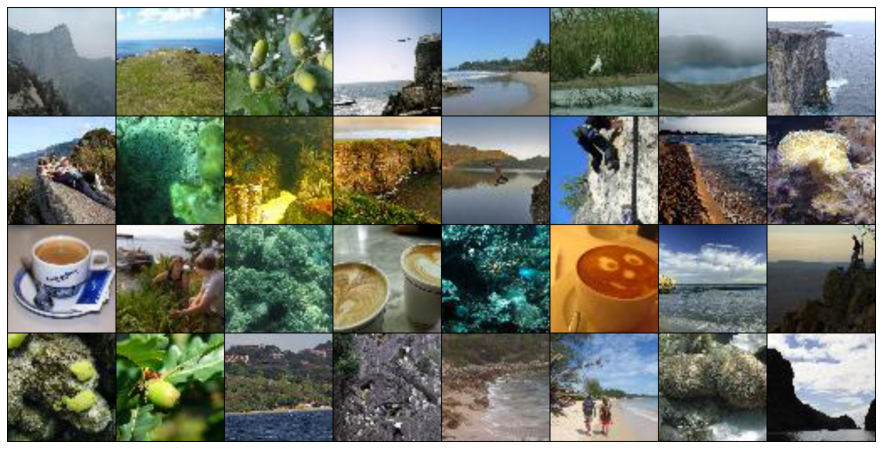

In [ ]:
from torchvision.utils import make_grid

for images, _ in train_loader:
    plt.figure(figsize=(16,8))
    plt.axis('off')
    plt.imshow(make_grid(images, nrow=8).permute((1, 2, 0)))
    break

### ImageDataLoader

### Jigsaw_ImageLoader

In [ ]:
import numpy as np
import torch
import torch.utils.data as data
import torchvision.transforms as transforms
from PIL import Image


class DataLoader(data.Dataset):
    def __init__(self, data_path, txt_list, classes=1000):
        self.data_path = data_path
        self.names, _ = self.__dataset_info(txt_list)
        self.N = len(self.names)
        self.permutations = self.__retrive_permutations(classes)

        self.__image_transformer = transforms.Compose([
            transforms.Resize(256, Image.BILINEAR),
            transforms.CenterCrop(255)])
        self.__augment_tile = transforms.Compose([
            transforms.RandomCrop(64),
            transforms.Resize((75, 75), Image.BILINEAR),
            transforms.Lambda(rgb_jittering),
            transforms.ToTensor(),
            # transforms.Normalize(mean=[0.485, 0.456, 0.406],
            # std =[0.229, 0.224, 0.225])
        ])

    def __getitem__(self, index):
        framename = self.data_path + '/' + self.names[index]


        img = Image.open(framename).convert('RGB')

        if np.random.rand() < 0.30:

            img = img

        if img.size[0] != 255:
            img = self.__image_transformer(img)

        s = (img.size[0]) / 3
        a = s / 2
        tiles = [None] * 9

        n = 0
        for i in range(3):
          for j in range(3):

            c = np.array([i*85,j*85,i*85+85,j*85+85]).astype(int)
  
            tile = img.crop(c.tolist())

            tile = self.__augment_tile(tile)

            # Normalize the patches indipendently to avoid low level features shortcut
            m, s = tile.view(3, -1).mean(dim=1).numpy(), tile.view(3, -1).std(dim=1).numpy()
            s[s == 0] = 1
            norm = transforms.Normalize(mean=m.tolist(), std=s.tolist())
            #tile = norm(tile)

            tiles[n] = tile
            n+=1

        order = np.random.randint(len(self.permutations))
        data = [tiles[self.permutations[order][t]] for t in range(9)]
        data = torch.stack(data, 0)

        return data, int(order), tiles

    def __len__(self):
        return len(self.names)

    def __dataset_info(self,txt_labels): #changed
        #txt_labels = self.txt_list #txtpath
        with open(txt_labels, 'r') as f:
            images_list = f.readlines()

        file_names = []
        labels = []
        for row in images_list:
          #print(row)

          row = row.rstrip('\n').split('\t')

          file_names.append(row[0])
          labels.append((row[1]))

        return file_names, labels 


    def __retrive_permutations(self, classes):
        all_perm = np.load('gdrive/MyDrive/permutations_%d.npy' % (classes))
        # from range [1,9] to [0,8]
        if all_perm.min() == 1:
            all_perm = all_perm - 1

        return all_perm


def rgb_jittering(im):
    im = np.array(im, 'int32')
    for ch in range(3):
        im[:, :, ch] += np.random.randint(-2, 2)
    im[im > 255] = 255
    im[im < 0] = 0
    return im.astype('uint8')


In [ ]:
perms = np.load('gdrive/MyDrive/permutations_1000.npy')
perms

array([[5, 8, 6, ..., 7, 3, 0],
       [3, 0, 2, ..., 1, 5, 8],
       [0, 1, 4, ..., 8, 7, 2],
       ...,
       [6, 4, 1, ..., 7, 5, 0],
       [4, 3, 6, ..., 7, 1, 0],
       [4, 5, 2, ..., 1, 7, 8]])

In [ ]:
# for img, label, in train_data:
#   print(img,label)
#   break
# plt.imshow(train_data[0][0][0][0])

In [ ]:
# data = 'gdrive/MyDrive/Colab Notebooks/deep learning/final/small-tiny-imagenet-200/'
# # trainpath = data + '/train'
# trainpath = data + 'train/n09246464/images'
# txtpath = data+'/train/n09246464/n09246464_boxes.txt'
# print(trainpath)
# #if os.path.exists(trainpath+'_255x255'):
#     #trainpath += '_255x255'
# train_data = DataLoader(trainpath , txtpath)

In [ ]:
#ls gdrive/MyDrive/Colab\ Notebooks/deep\ learning/final/small-tiny-imagenet-200/train/n09246464/images

## Utils

### Layers - class LRN

In [ ]:
"""
https://github.com/jiecaoyu/pytorch_imagenet/blob/master/networks/model_list/alexnet.py
"""
import torch.nn as nn

class LRN(nn.Module):
    def __init__(self, local_size=1, alpha=1.0, beta=0.75, ACROSS_CHANNELS=True):
        super(LRN, self).__init__()
        self.ACROSS_CHANNELS = ACROSS_CHANNELS
        if ACROSS_CHANNELS:
            self.average=nn.AvgPool3d(kernel_size=(local_size, 1, 1),
                    stride=1,padding=(int((local_size-1.0)/2), 0, 0))
        else:
            self.average=nn.AvgPool2d(kernel_size=local_size,
                    stride=1,padding=int((local_size-1.0)/2))
        self.alpha = alpha
        self.beta = beta


    def forward(self, x):
        if self.ACROSS_CHANNELS:
            div = x.pow(2).unsqueeze(1)
            div = self.average(div).squeeze(1)
            div = div.mul(self.alpha).add(1.0).pow(self.beta)
        else:
            div = x.pow(2)
            div = self.average(div)
            div = div.mul(self.alpha).add(1.0).pow(self.beta)
        x = x.div(div)
        return x

### TrainingUtils - LR + Accuracy

In [ ]:
def adjust_learning_rate(optimizer, epoch, init_lr=0.1, step=30, decay=0.1):
    """Sets the learning rate to the initial LR decayed by 10 every 30 epochs"""
    lr = init_lr * (decay ** (epoch // step))
    print('Learning Rate %f'%lr)
    for param_group in optimizer.param_groups:
        param_group['lr'] = lr
    return lr

def compute_accuracy(output, target, topk=(1,)):
    """Computes the precision@k for the specified values of k"""
    maxk = max(topk)
    batch_size = target.size(0)

    _, pred = output.topk(maxk, 1, True, True)
    pred = pred.t()
    correct = pred.eq(target.view(1, -1).expand_as(pred))

    res = []
    for k in topk:
        correct_k = correct[:k].reshape(-1).float().sum(0)
        res.append(correct_k.mul_(100.0 / batch_size))
    return res

In [ ]:
import tensorflow as tf
from PIL import Image
import numpy as np
import scipy.misc 
try:
    from io import StringIO  # Python 2.7
except ImportError:
    from io import BytesIO         # Python 3.x


class Logger(object):
    
    def __init__(self, log_dir):
        """Create a summary writer logging to log_dir."""
        self.writer = tf.summary.create_file_writer(log_dir)

    def scalar_summary(self, tag, value, step):
        """Log a scalar variable."""
        with self.writer.as_default():
            tf.summary.scalar(tag, value, step=step)
            self.writer.flush()
        # summary = tf.Summary(value=[tf.Summary.Value(tag=tag, simple_value=value)])
        # self.writer.add_summary(summary, step)

    def image_summary(self, tag, images, step):
        """Log a list of images."""

        img_summaries = []
        for i, img in enumerate(images):
            # Write the image to a string
            try:
                s = StringIO()
            except:
                s = BytesIO()
            Image.fromarray(img).save(s, format="png")

            # Create an Image object
            img_sum = tf.Summary.Image(encoded_image_string=s.getvalue(),
                                       height=img.shape[0],
                                       width=img.shape[1])
            # Create a Summary value
            img_summaries.append(tf.Summary.Value(tag='%s/%d' % (tag, i), image=img_sum))

        # Create and write Summary
        summary = tf.Summary(value=img_summaries)
        self.writer.add_summary(summary, step)
        
    def histo_summary(self, tag, values, step, bins=1000):
        """Log a histogram of the tensor of values."""

        # Create a histogram using numpy
        counts, bin_edges = np.histogram(values, bins=bins)

        # Fill the fields of the histogram proto
        hist = tf.HistogramProto()
        hist.min = float(np.min(values))
        hist.max = float(np.max(values))
        hist.num = int(np.prod(values.shape))
        hist.sum = float(np.sum(values))
        hist.sum_squares = float(np.sum(values**2))

        # Drop the start of the first bin
        bin_edges = bin_edges[1:]

        # Add bin edges and counts
        for edge in bin_edges:
            hist.bucket_limit.append(edge)
        for c in counts:
            hist.bucket.append(c)

        # Create and write Summary
        summary = tf.Summary(value=[tf.Summary.Value(tag=tag, histo=hist)])
        self.writer.add_summary(summary, step)
        self.writer.flush()

### visualization

In [ ]:
def visualization(data,permutation_list,true_perm_index,pred_perm_index,image_size = (3,255,255)):
# data: 9x3xWidthxHeight, one 9 tile image data
# permutation_list: 9x1000, the list to all permuations
# true_perm_index: int, index of the permutation
# pred_perm_index: int, index of predicted permuation


  true_label = permutation_list[true_perm_index]
  pred_label = permutation_list[pred_perm_index]

  
  data_array = data
  pred_data = [data_array[pred_label==i] for i in range(9)]
  truth_data = [data_array[true_label==i] for i in range(9)]
  width, height = image_size[1]/3,image_size[2]/3
  image_size = image_size

  
  img_data = torch.zeros(image_size)
  img_truth = torch.zeros(image_size)
  img_pred = torch.zeros(image_size)
  index = 0
  for i in range(3):
    for j in range(3):

      w = int(width * j)
      h = int(height * i)
      img_data[:,w:w+75,h:h+75] = data_array[index]
      img_truth[:,w:w+75,h:h+75] = truth_data[index]
      img_pred[:,w:w+75,h:h+75] = pred_data[index]
      index += 1
  dtp = (np.transpose(img_data, (1, 2, 0)),np.transpose(img_truth, (1, 2, 0)),np.transpose(img_pred, (1, 2, 0)))

  fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(12,4))
  title = ('data','truth {}: {}'.format(true_perm_index,true_label),'prediction {}: {}'.format(pred_perm_index,pred_label))
  for i, ax in enumerate(axs.flatten()):
      plt.sca(ax)
      plt.imshow(dtp[i], cmap=plt.cm.jet)

      plt.title(title[i])
  plt.show()




# JigsawNetwork

In [ ]:
import torch
import torch.nn as nn
from torch import cat
import torch.nn.init as init

import sys
#sys.path.append('Utils')
#from Layers import LRN

class Network(nn.Module):

    def __init__(self, classes=1000):
        super(Network, self).__init__()
 
        self.conv = nn.Sequential()
        self.conv.add_module('conv1_s1',nn.Conv2d(3, 96, kernel_size=11, stride=2, padding=0))
        self.conv.add_module('relu1_s1',nn.ReLU(inplace=True))
        self.conv.add_module('pool1_s1',nn.MaxPool2d(kernel_size=3, stride=2))
        self.conv.add_module('lrn1_s1',LRN(local_size=5, alpha=0.0001, beta=0.75))

        self.conv.add_module('conv2_s1',nn.Conv2d(96, 256, kernel_size=5, padding=2, groups=2))
        self.conv.add_module('relu2_s1',nn.ReLU(inplace=True))
        self.conv.add_module('pool2_s1',nn.MaxPool2d(kernel_size=3, stride=2))
        self.conv.add_module('lrn2_s1',LRN(local_size=5, alpha=0.0001, beta=0.75))

        self.conv.add_module('conv3_s1',nn.Conv2d(256, 384, kernel_size=3, padding=1))
        self.conv.add_module('relu3_s1',nn.ReLU(inplace=True))

        self.conv.add_module('conv4_s1',nn.Conv2d(384, 384, kernel_size=3, padding=1, groups=2))
        self.conv.add_module('relu4_s1',nn.ReLU(inplace=True))

        self.conv.add_module('conv5_s1',nn.Conv2d(384, 256, kernel_size=3, padding=1, groups=2))
        self.conv.add_module('relu5_s1',nn.ReLU(inplace=True))
        self.conv.add_module('pool5_s1',nn.MaxPool2d(kernel_size=3, stride=2))

        self.fc6 = nn.Sequential()
        self.fc6.add_module('fc6_s1',nn.Linear(256*3*3, 1024))
        self.fc6.add_module('relu6_s1',nn.ReLU(inplace=True))
        self.fc6.add_module('drop6_s1',nn.Dropout(p=0.5))

        self.fc7 = nn.Sequential()
        self.fc7.add_module('fc7',nn.Linear(9*1024,4096))
        self.fc7.add_module('relu7',nn.ReLU(inplace=True))
        self.fc7.add_module('drop7',nn.Dropout(p=0.5))

        self.classifier = nn.Sequential()
        self.classifier.add_module('fc8',nn.Linear(4096, classes))
        
        #self.apply(weights_init)

    def load(self,checkpoint):
        model_dict = self.state_dict()
        pretrained_dict = torch.load(checkpoint)
        pretrained_dict = {k: v for k, v in list(pretrained_dict.items()) if k in model_dict and 'fc8' not in k}
        model_dict.update(pretrained_dict)
        self.load_state_dict(model_dict)
        print([k for k, v in list(pretrained_dict.items())])

    def save(self,checkpoint):
        torch.save(self.state_dict(), checkpoint)
    
    def forward(self, x):
        B,T,C,H,W = x.size()
        x = x.transpose(0,1)

        x_list = []
        for i in range(9):
            z = self.conv(x[i])
            z = self.fc6(z.view(B,-1))
            z = z.view([B,1,-1])
            x_list.append(z)

        x = cat(x_list,1)
        x = self.fc7(x.view(B,-1))
        x = self.classifier(x)

        return x


def weights_init(model):
    if type(model) in [nn.Conv2d,nn.Linear]:
        nn.init.xavier_normal(model.weight.data)
        nn.init.constant(model.bias.data, 0.1)
    


# Train with JigResnet

## JigResnet

In [ ]:
class JigResnet(nn.Module):

    def __init__(self, classes=1000):
        super(JigResnet, self).__init__()
        self.resnet18 = models.resnet18()
        #self.resnet50 = models.resnet50()
        self.conv = nn.Sequential()
        self.conv.add_module('conv1_s1',nn.Conv2d(3, 96, kernel_size=11, stride=2, padding=0))
        self.conv.add_module('relu1_s1',nn.ReLU(inplace=True))
        self.conv.add_module('pool1_s1',nn.MaxPool2d(kernel_size=3, stride=2))
        self.conv.add_module('lrn1_s1',LRN(local_size=5, alpha=0.0001, beta=0.75))

        self.conv.add_module('conv2_s1',nn.Conv2d(96, 256, kernel_size=5, padding=2, groups=2))
        self.conv.add_module('relu2_s1',nn.ReLU(inplace=True))
        self.conv.add_module('pool2_s1',nn.MaxPool2d(kernel_size=3, stride=2))
        self.conv.add_module('lrn2_s1',LRN(local_size=5, alpha=0.0001, beta=0.75))

        self.conv.add_module('conv3_s1',nn.Conv2d(256, 384, kernel_size=3, padding=1))
        self.conv.add_module('relu3_s1',nn.ReLU(inplace=True))

        self.conv.add_module('conv4_s1',nn.Conv2d(384, 384, kernel_size=3, padding=1, groups=2))
        self.conv.add_module('relu4_s1',nn.ReLU(inplace=True))

        self.conv.add_module('conv5_s1',nn.Conv2d(384, 256, kernel_size=3, padding=1, groups=2))
        self.conv.add_module('relu5_s1',nn.ReLU(inplace=True))
        self.conv.add_module('pool5_s1',nn.MaxPool2d(kernel_size=3, stride=2))

        self.fc6 = nn.Sequential()
        self.fc6.add_module('fc6_s1',nn.Linear(256*3*3, 1024))
        self.fc6.add_module('relu6_s1',nn.ReLU(inplace=True))
        self.fc6.add_module('drop6_s1',nn.Dropout(p=0.5))

        self.fc7 = nn.Sequential()
        self.fc7.add_module('fc7',nn.Linear(9*1000,4096))
        self.fc7.add_module('relu7',nn.ReLU(inplace=True))
        self.fc7.add_module('drop7',nn.Dropout(p=0.5))

        self.classifier = nn.Sequential()
        self.classifier.add_module('fc8',nn.Linear(4096, classes))
        
        #self.apply(weights_init)

    def load(self,checkpoint):
        model_dict = self.state_dict()
        pretrained_dict = torch.load(checkpoint)
        pretrained_dict = {k: v for k, v in list(pretrained_dict.items()) if k in model_dict and 'fc8' not in k}
        model_dict.update(pretrained_dict)
        self.load_state_dict(model_dict)
        print([k for k, v in list(pretrained_dict.items())])

    def save(self,checkpoint):
        torch.save(self.state_dict(), checkpoint)
    
    def forward(self, x):
 
        B,T,C,H,W = x.size()
        x = x.transpose(0,1)

        x_list = []
        for i in range(9):
            z = self.resnet18(x[i])
            #z = self.fc6(z.view(B,-1))
            z = z.view([B,1,-1])
            x_list.append(z)

        x = cat(x_list,1)
        x = self.fc7(x.view(B,-1))
        x = self.classifier(x)

        return x


def weights_init(model):
    if type(model) in [nn.Conv2d,nn.Linear]:
        nn.init.xavier_normal(model.weight.data)
        nn.init.constant(model.bias.data, 0.1)
    


## JigResnet Train

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:281: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "


<Figure size 432x288 with 0 Axes>

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:70: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Top 5 accuracy 86.0
[ 1/300]     0) [batch load  0.018sec, net 0.13sec], LR 0.00100, Loss:  1.576, Accuracy  57.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 87.0
[ 1/300]     4) [batch load  0.018sec, net 0.05sec], LR 0.00100, Loss:  1.649, Accuracy  52.00%


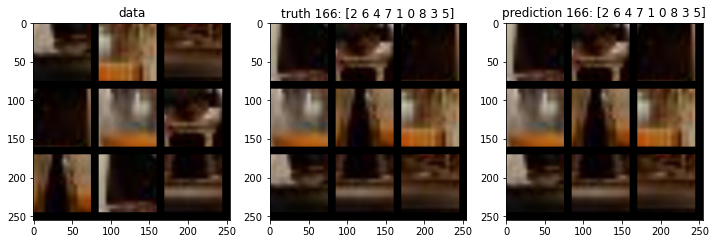

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 88.0
[ 2/300]     8) [batch load  0.017sec, net 0.04sec], LR 0.00100, Loss:  1.749, Accuracy  48.00%


<Figure size 432x288 with 0 Axes>

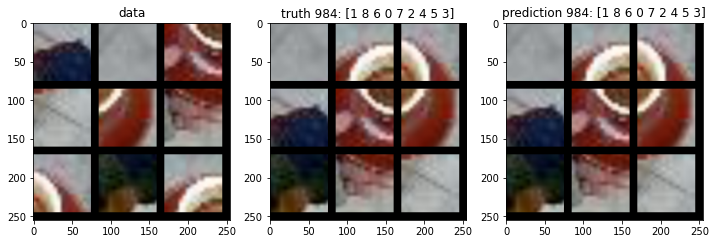

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 75.0
[ 3/300]    12) [batch load  0.017sec, net 0.04sec], LR 0.00100, Loss:  2.139, Accuracy  44.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

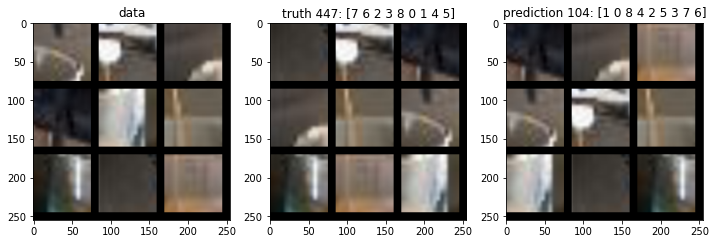

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 87.0
[ 4/300]    16) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.833, Accuracy  48.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

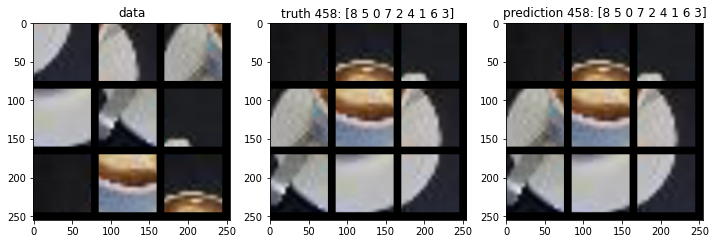

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 85.0
[ 5/300]    20) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.865, Accuracy  45.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 85.0
[ 5/300]    24) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.969, Accuracy  41.00%


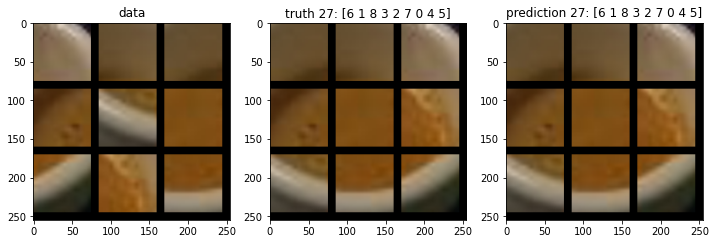

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 74.0
[ 6/300]    28) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  2.468, Accuracy  36.00%


<Figure size 432x288 with 0 Axes>

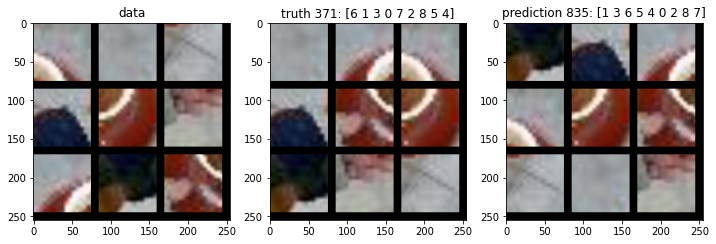

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 82.0
[ 7/300]    32) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.986, Accuracy  48.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

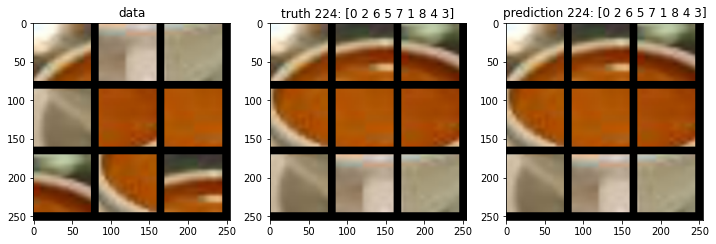

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 75.0
[ 8/300]    36) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  2.231, Accuracy  40.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

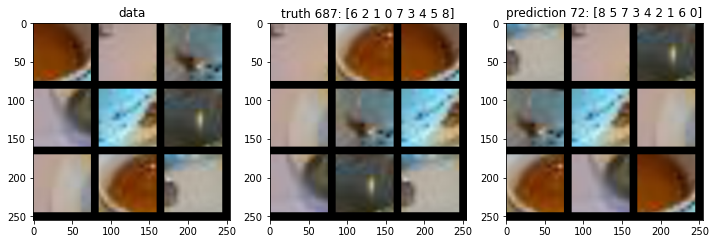

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 83.0
[ 9/300]    40) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  2.155, Accuracy  41.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 87.0
[ 9/300]    44) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.887, Accuracy  43.00%


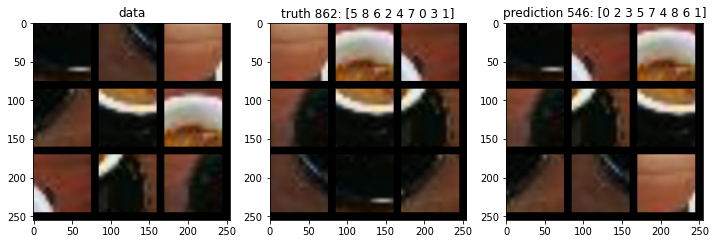

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 80.0
[10/300]    48) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.835, Accuracy  48.00%


<Figure size 432x288 with 0 Axes>

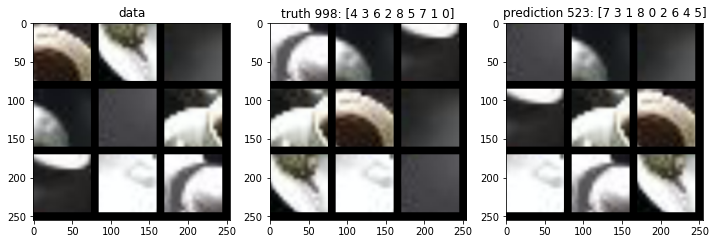

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 88.0
[11/300]    52) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.834, Accuracy  42.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

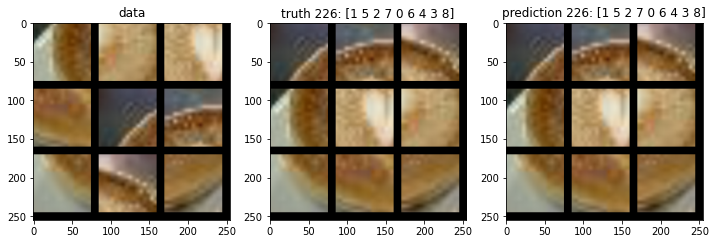

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 91.0
[12/300]    56) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.793, Accuracy  43.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

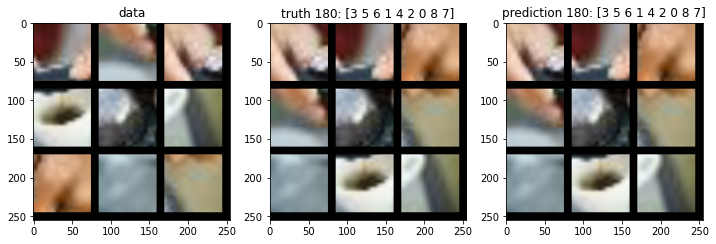

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 86.0
[13/300]    60) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.707, Accuracy  52.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 76.0
[13/300]    64) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  2.224, Accuracy  40.00%


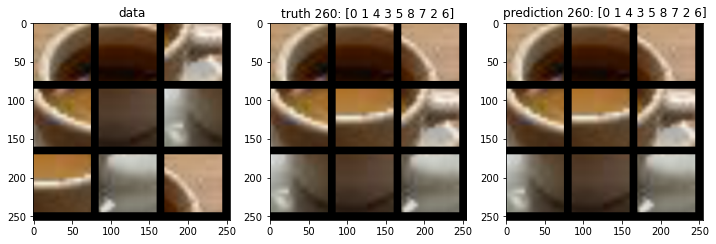

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 77.0
[14/300]    68) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  2.246, Accuracy  38.00%


<Figure size 432x288 with 0 Axes>

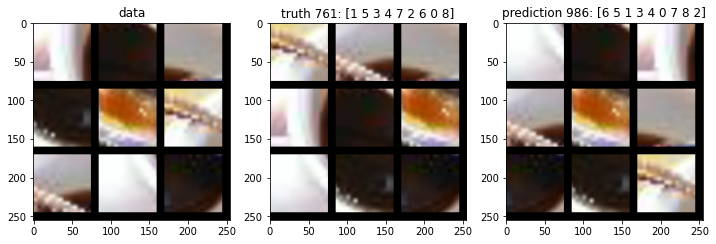

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 77.0
[15/300]    72) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  2.194, Accuracy  36.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

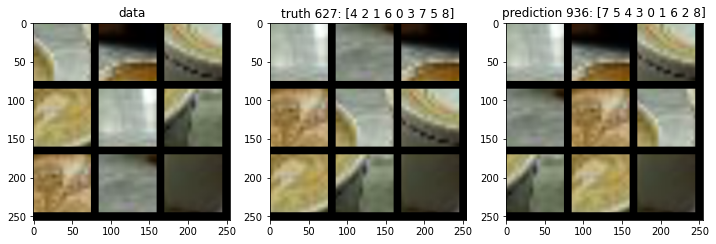

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 74.0
[16/300]    76) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  2.178, Accuracy  43.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

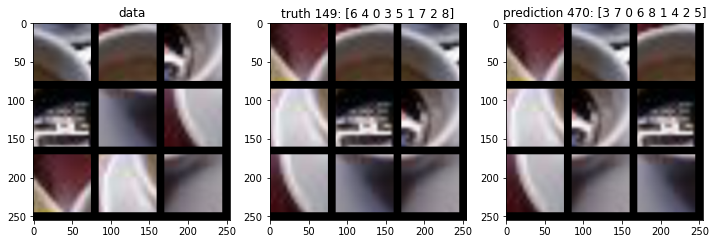

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 79.0
[17/300]    80) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  2.145, Accuracy  41.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 80.0
[17/300]    84) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.997, Accuracy  42.00%


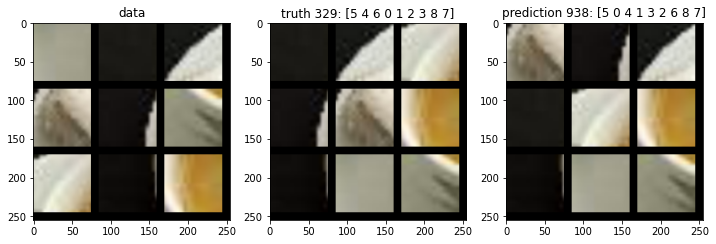

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 77.0
[18/300]    88) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  2.008, Accuracy  43.00%


<Figure size 432x288 with 0 Axes>

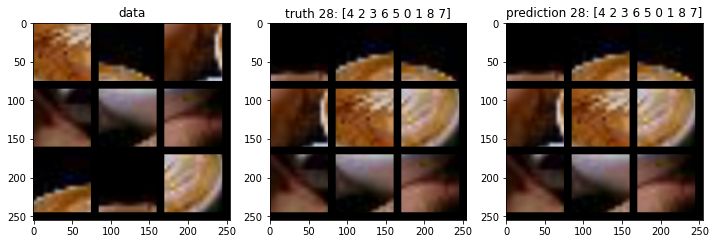

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 91.0
[19/300]    92) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.570, Accuracy  55.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

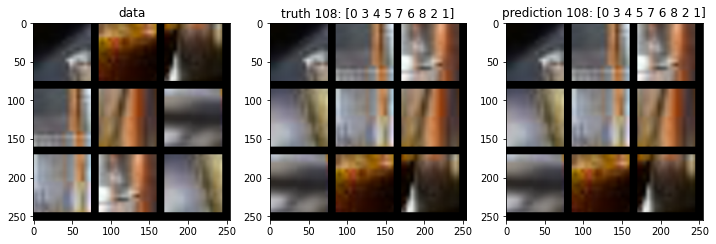

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 83.0
[20/300]    96) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.904, Accuracy  45.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

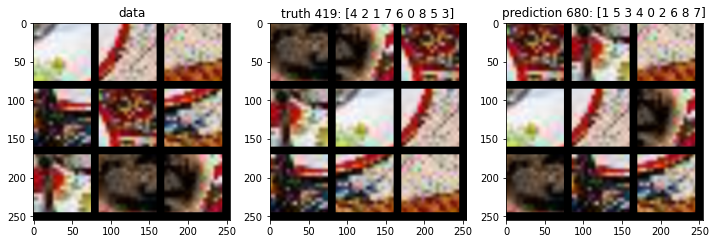

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 85.0
[21/300]   100) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  2.007, Accuracy  41.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 85.0
[21/300]   104) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.765, Accuracy  52.00%


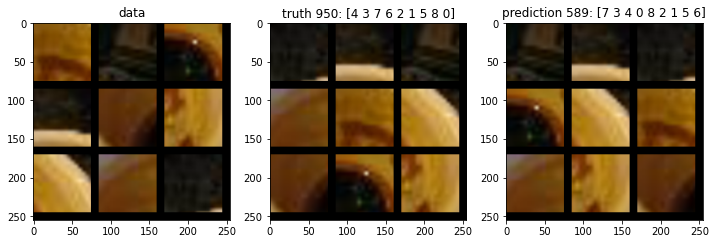

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 78.0
[22/300]   108) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  2.046, Accuracy  48.00%


<Figure size 432x288 with 0 Axes>

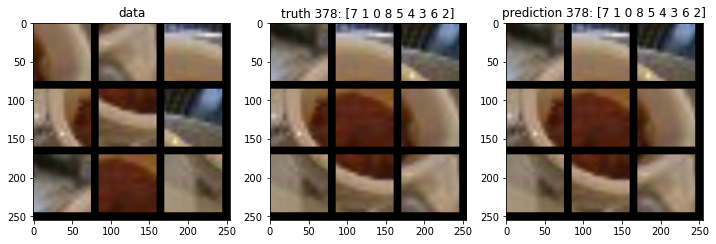

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 81.0
[23/300]   112) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.941, Accuracy  47.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

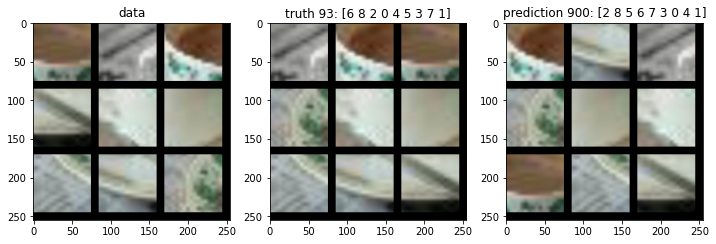

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 85.0
[24/300]   116) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.759, Accuracy  52.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

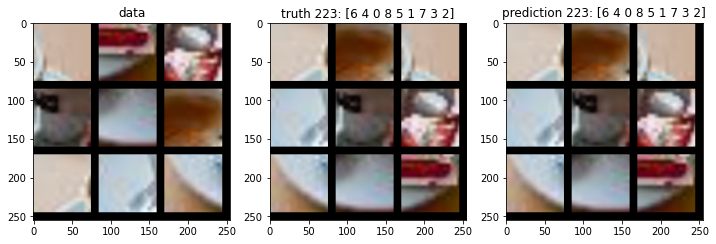

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 86.0
[25/300]   120) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.876, Accuracy  46.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 85.0
[25/300]   124) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.745, Accuracy  55.00%


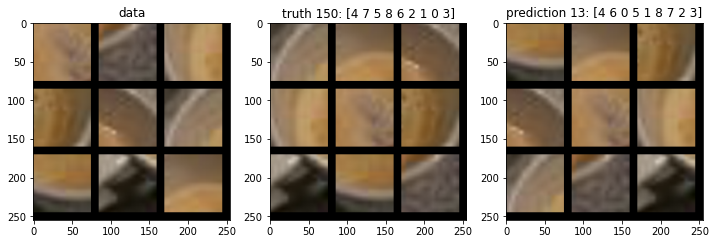

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 81.0
[26/300]   128) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.882, Accuracy  47.00%


<Figure size 432x288 with 0 Axes>

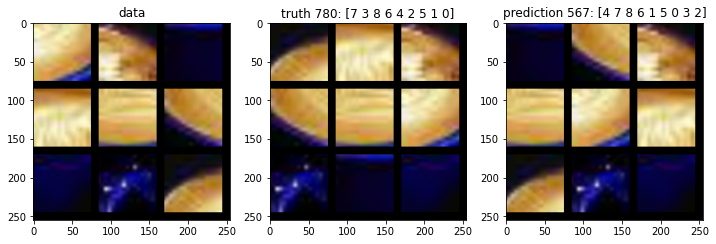

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 79.0
[27/300]   132) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  2.073, Accuracy  42.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

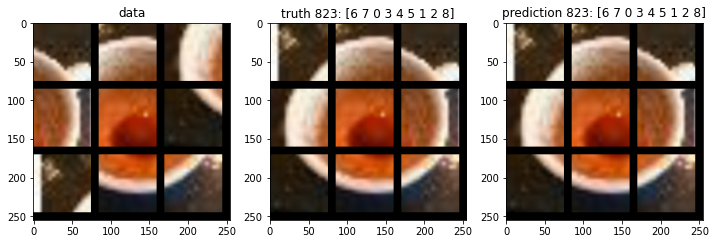

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 90.0
[28/300]   136) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.584, Accuracy  53.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

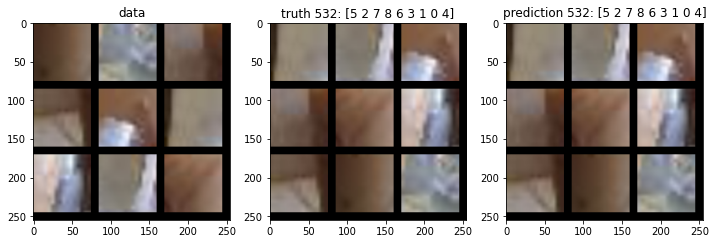

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 88.0
[29/300]   140) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.507, Accuracy  60.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[29/300]   144) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.580, Accuracy  54.00%


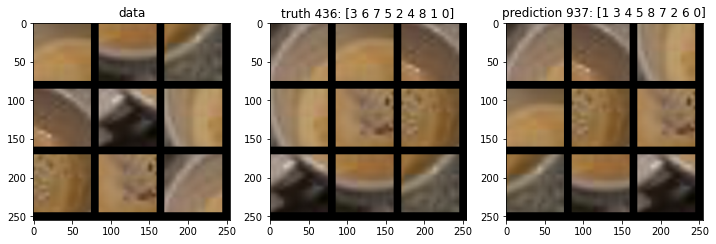

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 87.0
[30/300]   148) [batch load  0.017sec, net 0.03sec], LR 0.00100, Loss:  1.741, Accuracy  51.00%


<Figure size 432x288 with 0 Axes>

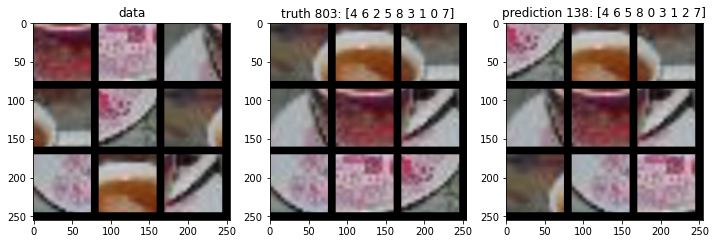

Learning Rate 0.000125


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 89.0
[31/300]   152) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  1.825, Accuracy  46.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

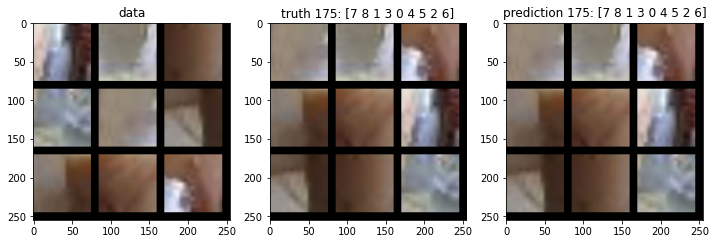

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 80.0
[32/300]   156) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  2.002, Accuracy  43.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

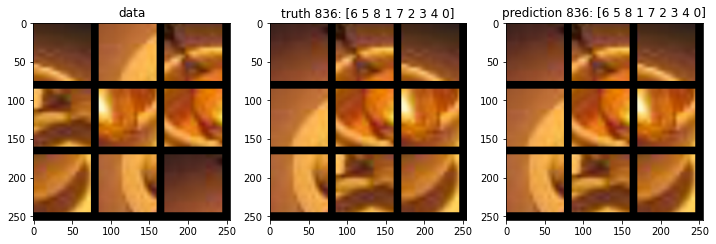

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 91.0
[33/300]   160) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  1.547, Accuracy  57.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 90.0
[33/300]   164) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  1.359, Accuracy  65.00%


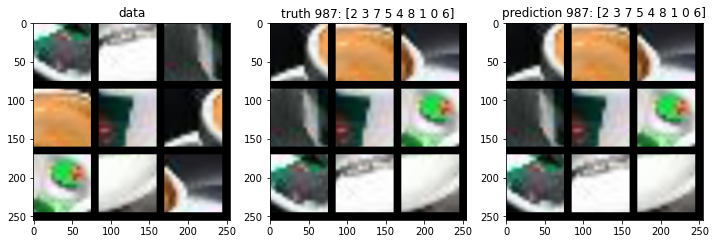

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 91.0
[34/300]   168) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  1.471, Accuracy  57.00%


<Figure size 432x288 with 0 Axes>

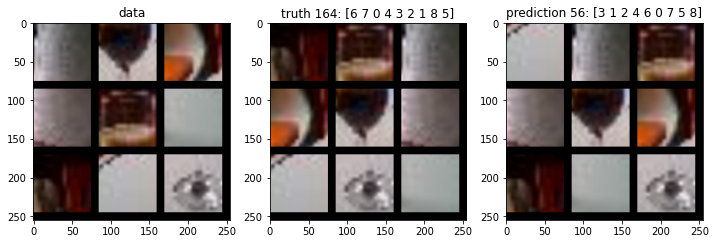

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 91.0
[35/300]   172) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  1.377, Accuracy  61.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

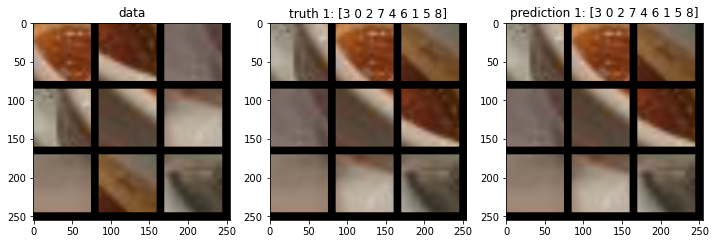

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 90.0
[36/300]   176) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  1.346, Accuracy  62.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

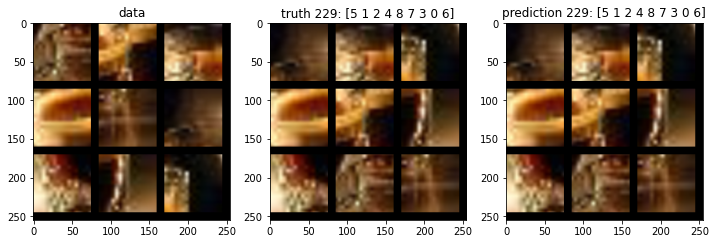

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[37/300]   180) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  1.180, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[37/300]   184) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  1.267, Accuracy  63.00%


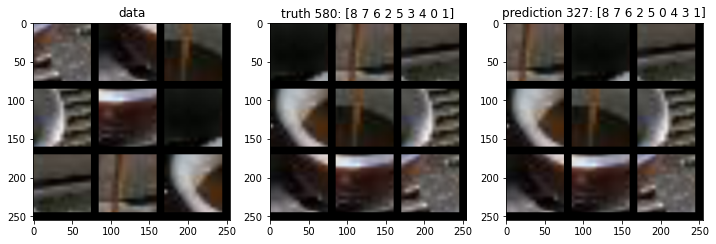

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 90.0
[38/300]   188) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  1.375, Accuracy  61.00%


<Figure size 432x288 with 0 Axes>

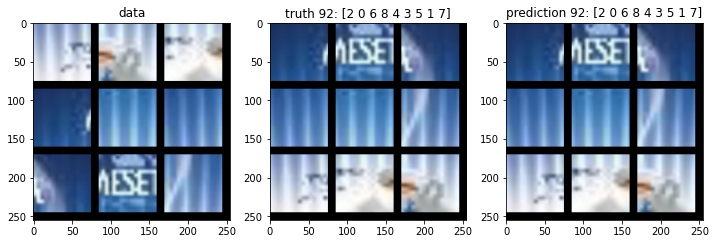

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 89.0
[39/300]   192) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  1.434, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

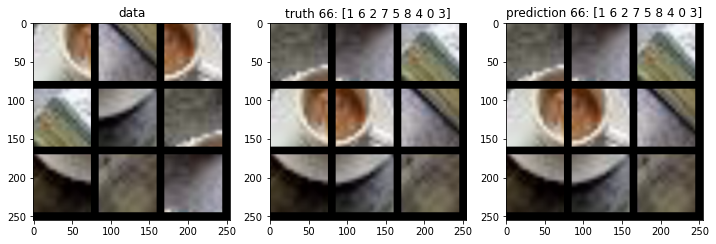

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[40/300]   196) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  1.187, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

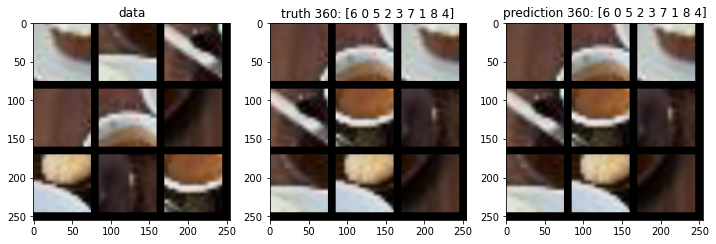

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[41/300]   200) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  1.435, Accuracy  56.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[41/300]   204) [batch load  0.017sec, net 0.03sec], LR 0.00013, Loss:  1.146, Accuracy  73.00%


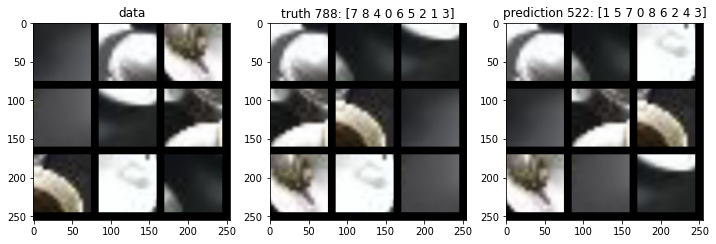

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 91.0
[42/300]   208) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.380, Accuracy  63.00%


<Figure size 432x288 with 0 Axes>

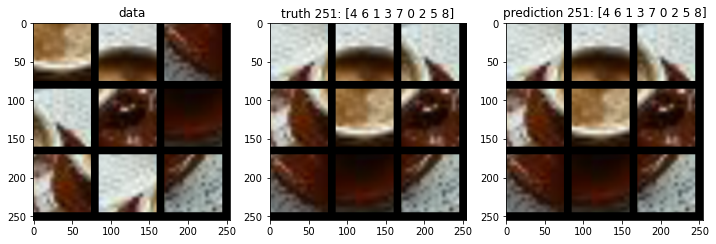

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[43/300]   212) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.137, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

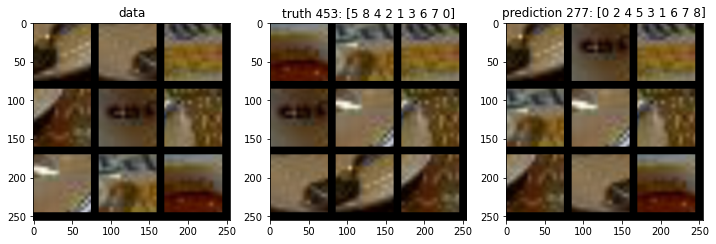

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[44/300]   216) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.194, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

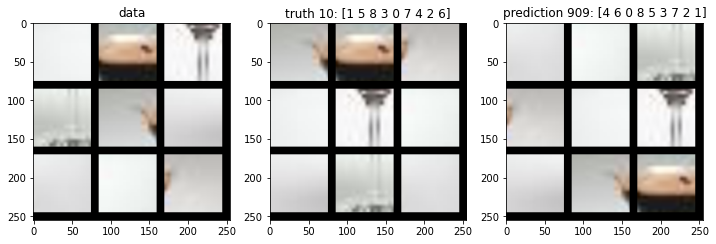

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[45/300]   220) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.148, Accuracy  62.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[45/300]   224) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.407, Accuracy  63.00%


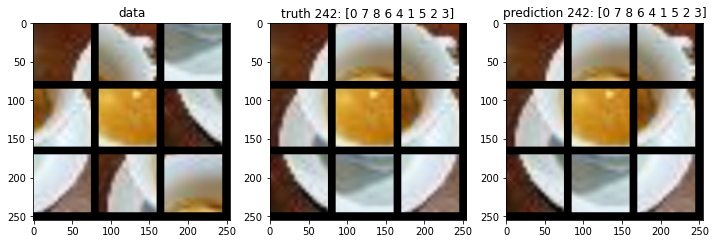

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 91.0
[46/300]   228) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.346, Accuracy  58.00%


<Figure size 432x288 with 0 Axes>

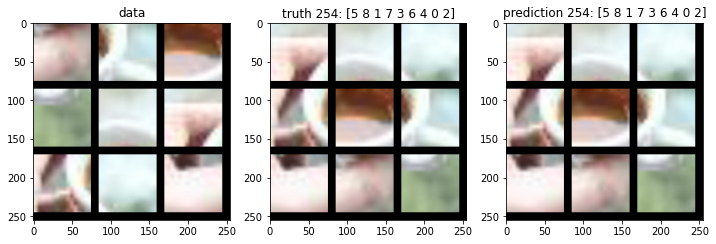

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[47/300]   232) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.284, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

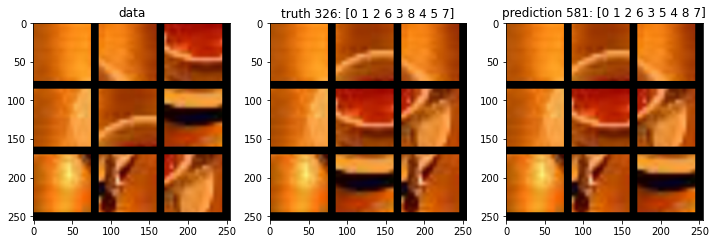

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 90.0
[48/300]   236) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.565, Accuracy  48.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

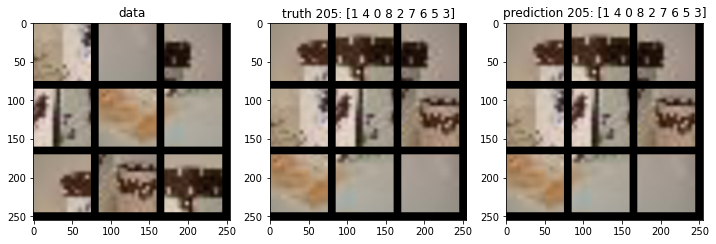

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[49/300]   240) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.226, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[49/300]   244) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.291, Accuracy  61.00%


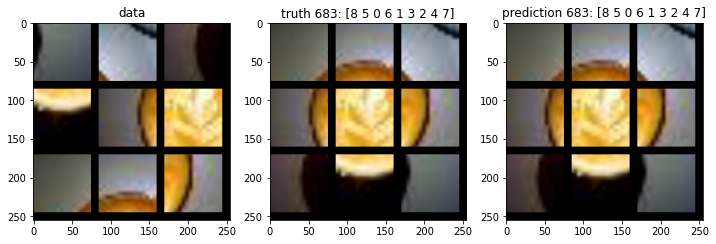

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[50/300]   248) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.264, Accuracy  70.00%


<Figure size 432x288 with 0 Axes>

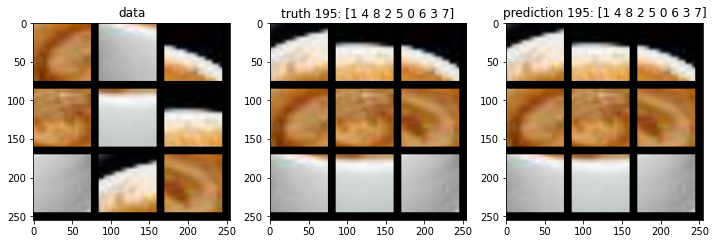

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[51/300]   252) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.461, Accuracy  53.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

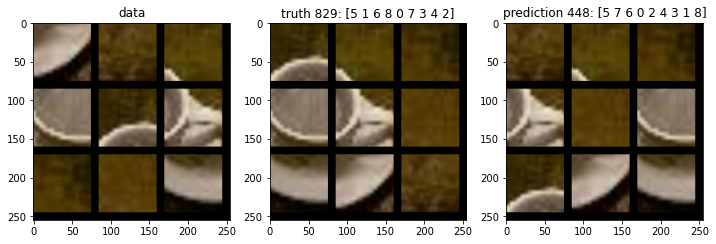

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[52/300]   256) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.182, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

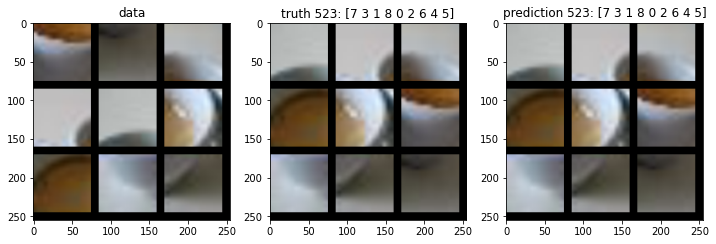

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[53/300]   260) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.360, Accuracy  59.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[53/300]   264) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.139, Accuracy  65.00%


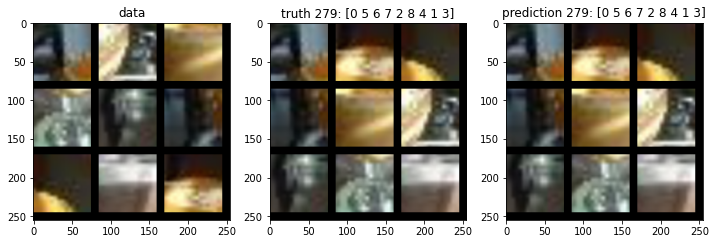

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[54/300]   268) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.304, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

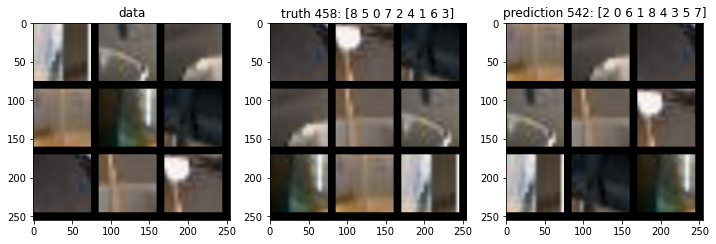

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[55/300]   272) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.421, Accuracy  56.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

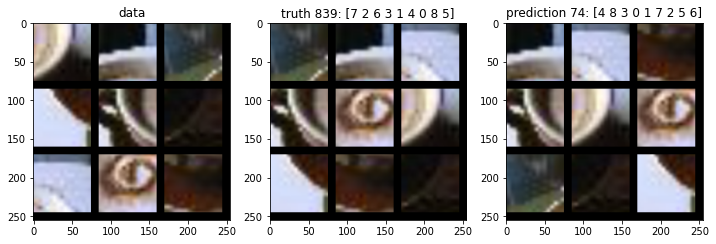

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[56/300]   276) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.198, Accuracy  62.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

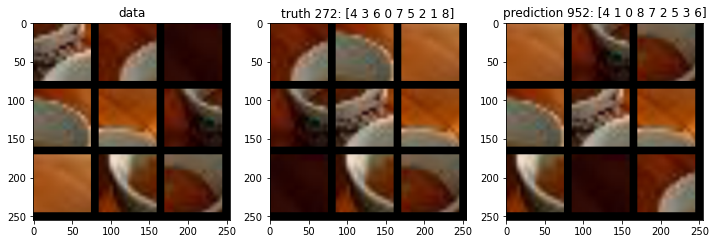

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[57/300]   280) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.152, Accuracy  70.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[57/300]   284) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.370, Accuracy  65.00%


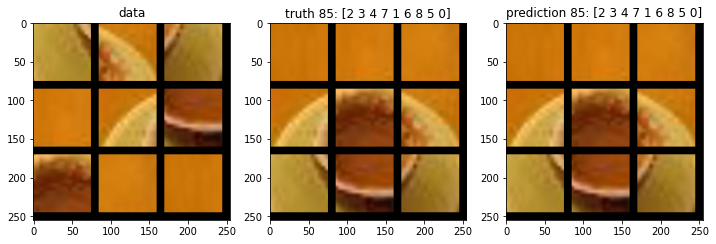

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 99.0
[58/300]   288) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.179, Accuracy  63.00%


<Figure size 432x288 with 0 Axes>

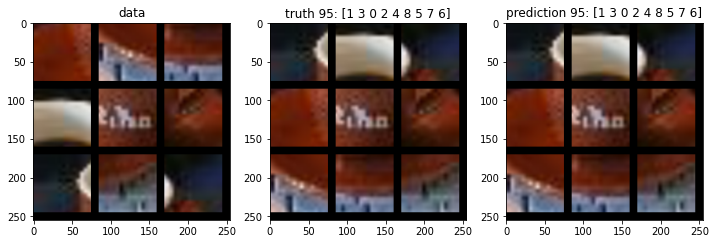

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[59/300]   292) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.098, Accuracy  71.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

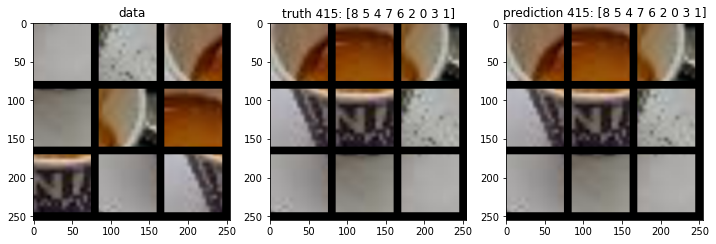

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[60/300]   296) [batch load  0.017sec, net 0.04sec], LR 0.00013, Loss:  1.023, Accuracy  70.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

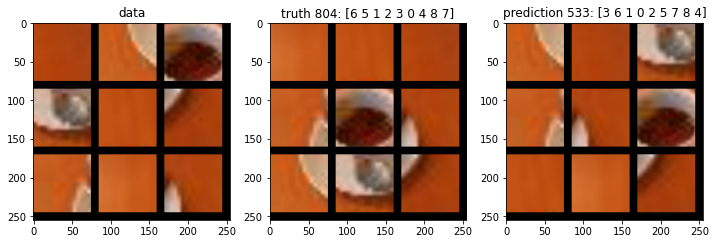

Learning Rate 0.000016


<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[61/300]   300) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.117, Accuracy  73.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[61/300]   304) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.116, Accuracy  68.00%


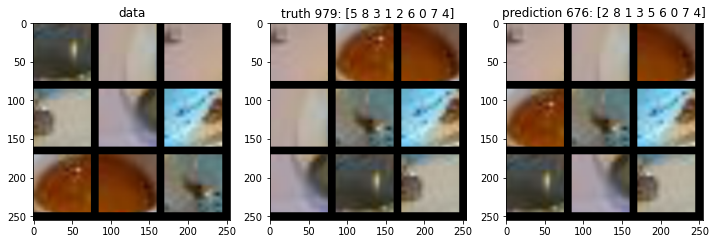

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 99.0
[62/300]   308) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  0.848, Accuracy  78.00%


<Figure size 432x288 with 0 Axes>

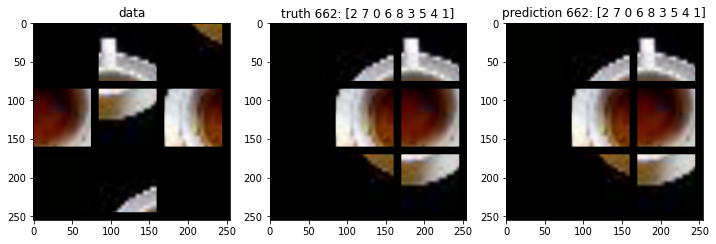

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[63/300]   312) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.161, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

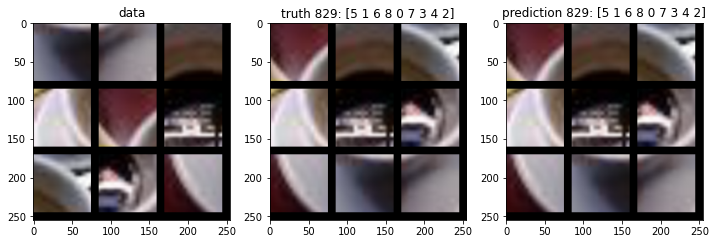

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[64/300]   316) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.245, Accuracy  63.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

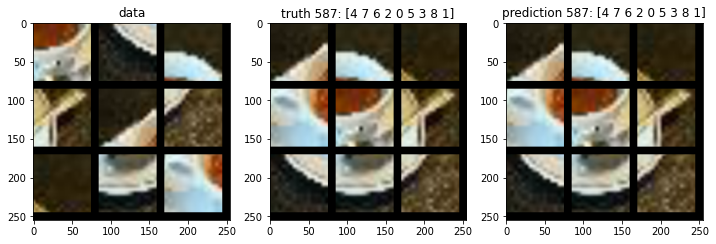

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 99.0
[65/300]   320) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  0.983, Accuracy  71.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[65/300]   324) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.143, Accuracy  65.00%


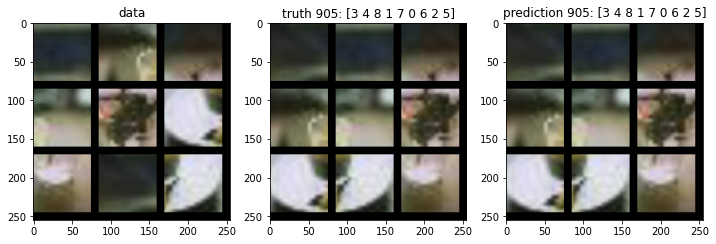

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[66/300]   328) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.227, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

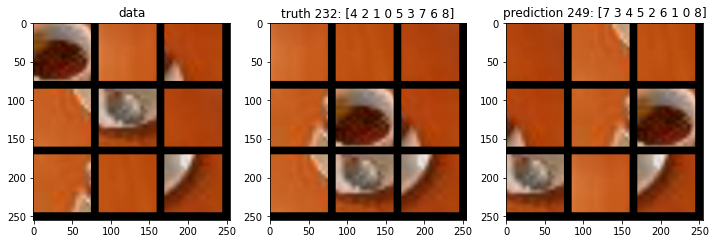

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 91.0
[67/300]   332) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.434, Accuracy  57.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

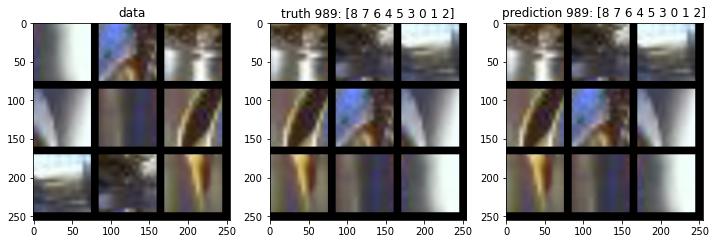

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[68/300]   336) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.202, Accuracy  73.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

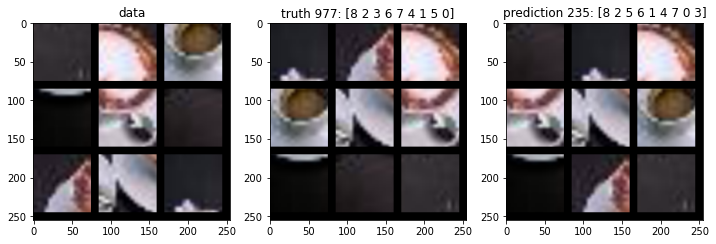

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[69/300]   340) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.159, Accuracy  74.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[69/300]   344) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.207, Accuracy  65.00%


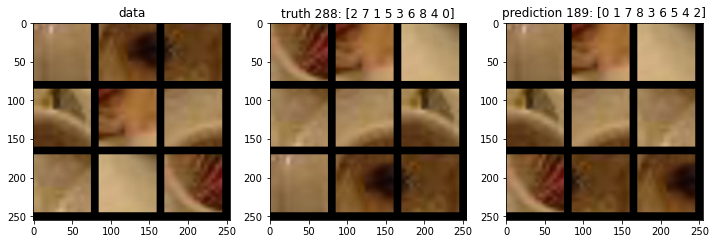

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[70/300]   348) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.094, Accuracy  70.00%


<Figure size 432x288 with 0 Axes>

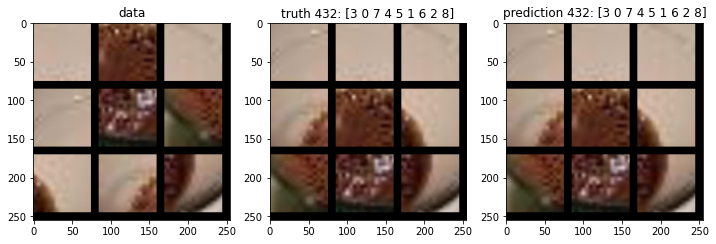

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[71/300]   352) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.046, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

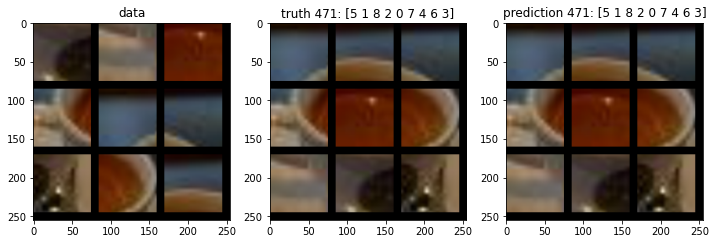

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[72/300]   356) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.075, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

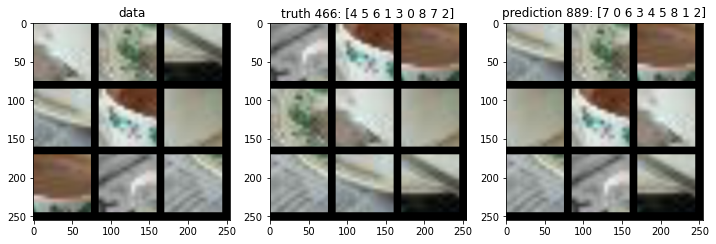

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[73/300]   360) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.214, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[73/300]   364) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.117, Accuracy  65.00%


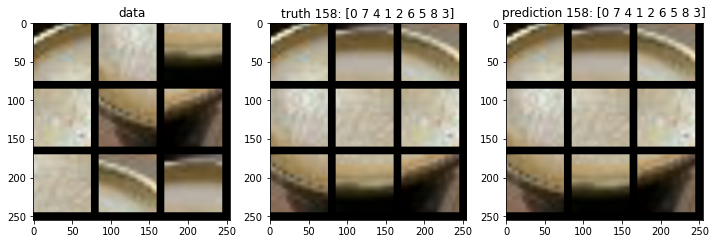

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 91.0
[74/300]   368) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.250, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

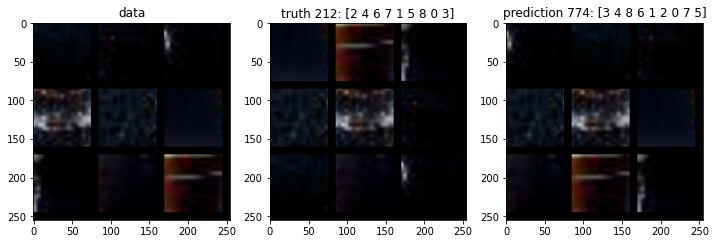

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[75/300]   372) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.178, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

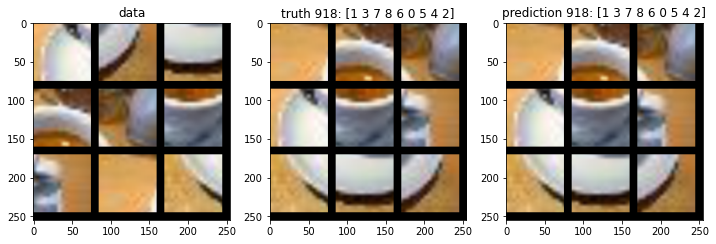

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[76/300]   376) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.123, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

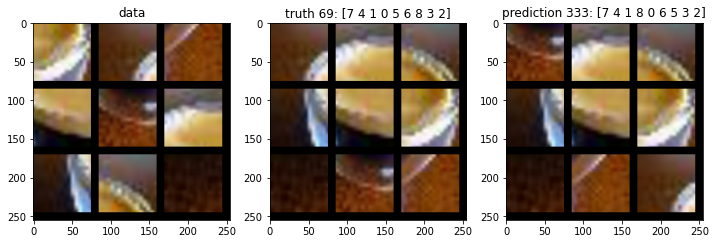

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[77/300]   380) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.111, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[77/300]   384) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.015, Accuracy  70.00%


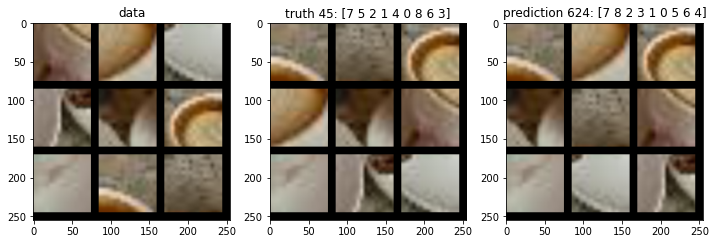

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[78/300]   388) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.199, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

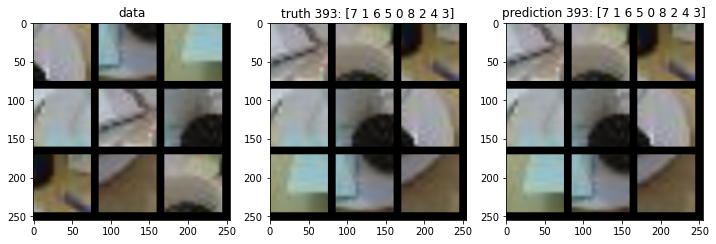

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[79/300]   392) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.128, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

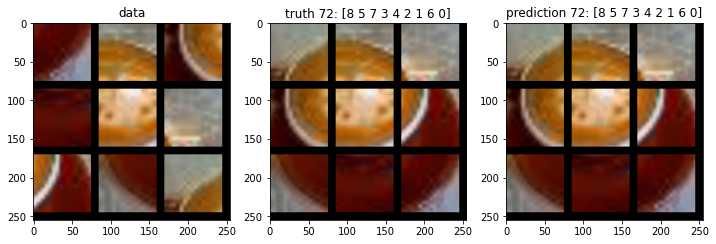

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[80/300]   396) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.149, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

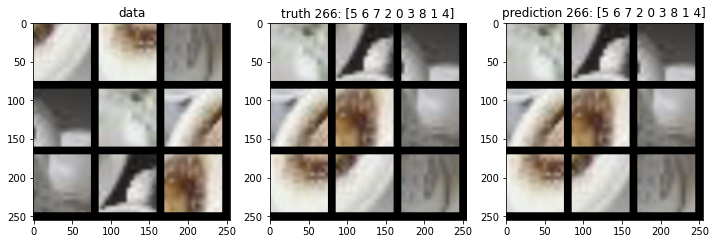

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[81/300]   400) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.058, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 99.0
[81/300]   404) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.126, Accuracy  64.00%


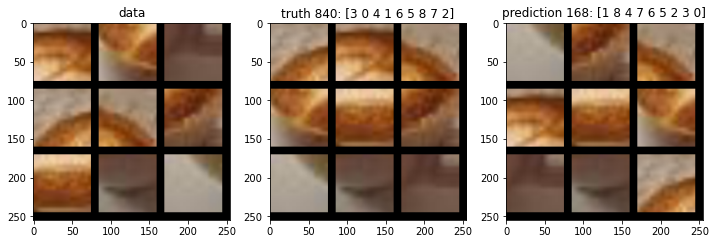

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[82/300]   408) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.136, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

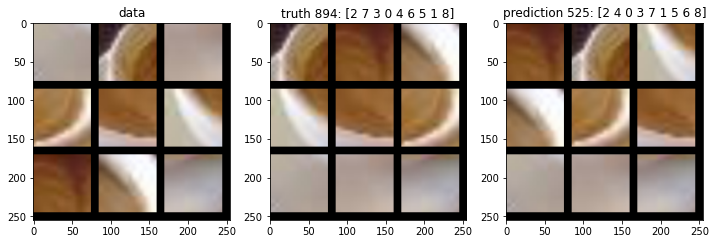

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 100.0
[83/300]   412) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.117, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

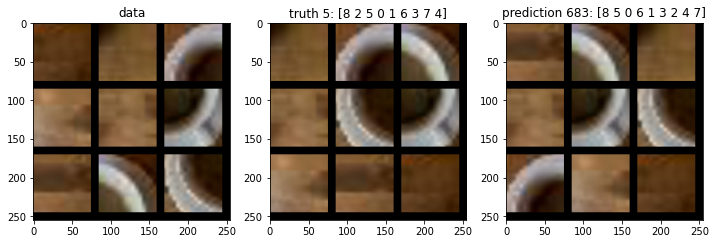

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[84/300]   416) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.305, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

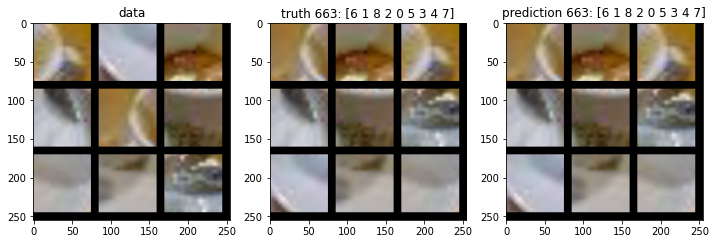

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[85/300]   420) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.057, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[85/300]   424) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.111, Accuracy  70.00%


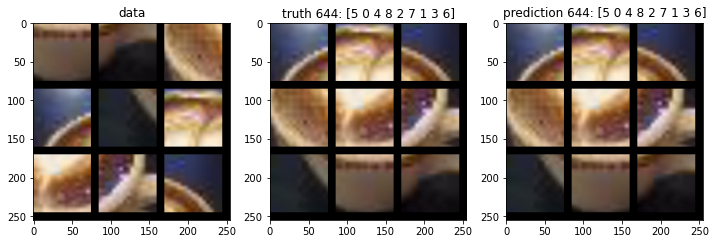

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[86/300]   428) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.066, Accuracy  71.00%


<Figure size 432x288 with 0 Axes>

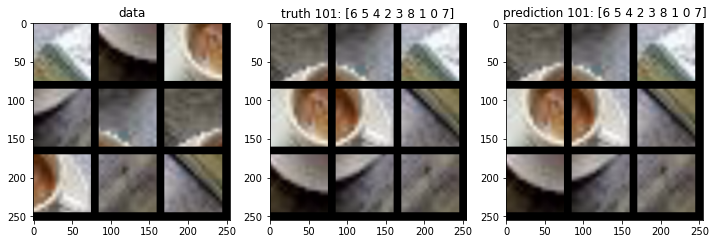

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[87/300]   432) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.076, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

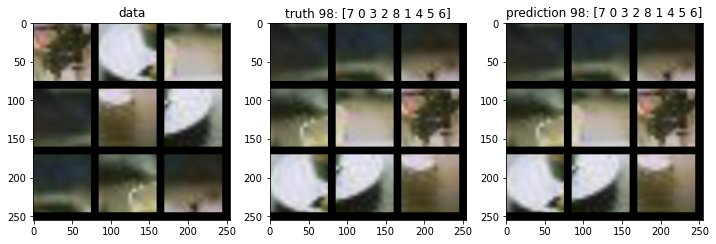

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[88/300]   436) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.102, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

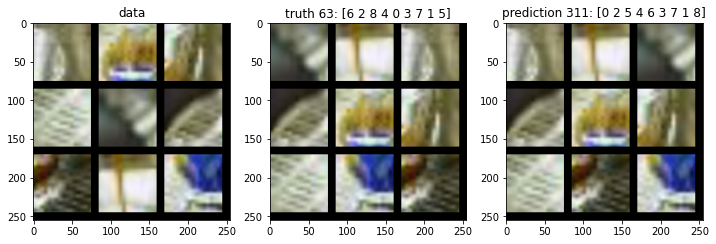

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[89/300]   440) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.298, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[89/300]   444) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.138, Accuracy  70.00%


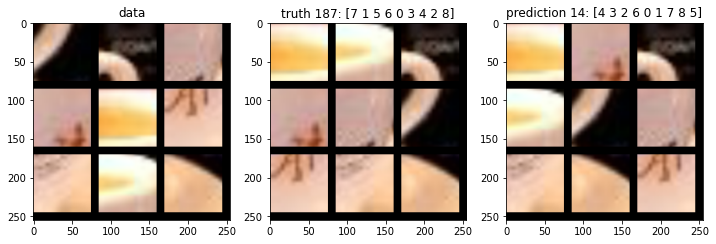

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[90/300]   448) [batch load  0.017sec, net 0.04sec], LR 0.00002, Loss:  1.149, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

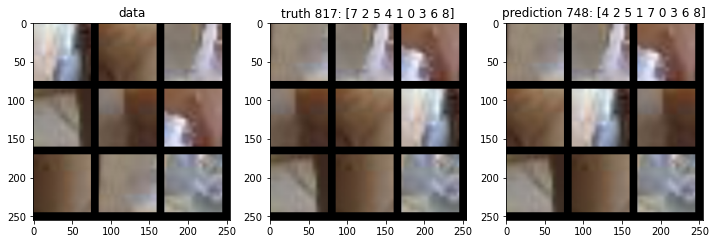

Learning Rate 0.000002


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[91/300]   452) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.178, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

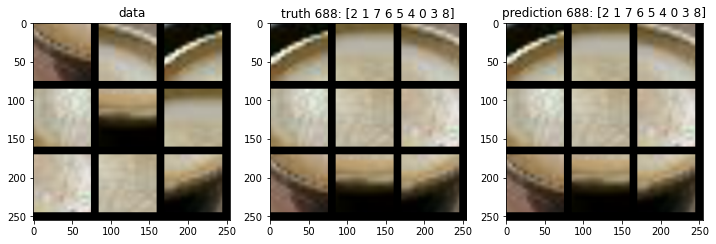

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[92/300]   456) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.969, Accuracy  76.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

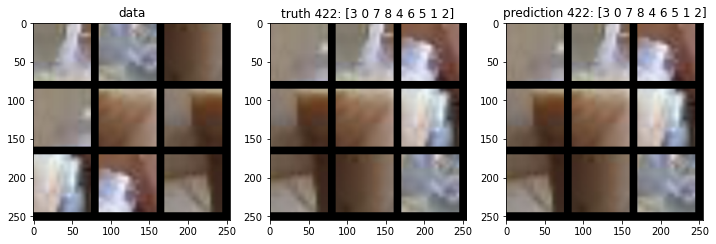

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[93/300]   460) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.380, Accuracy  61.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[93/300]   464) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.242, Accuracy  63.00%


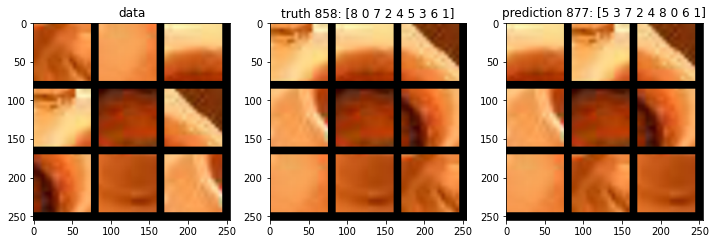

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[94/300]   468) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.106, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

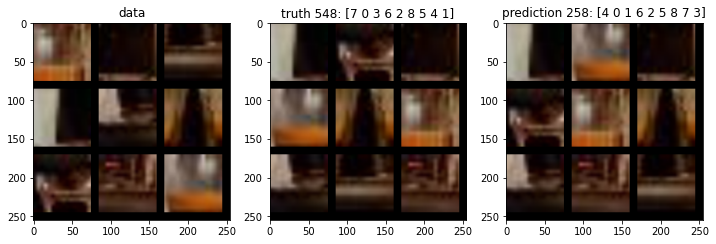

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[95/300]   472) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.126, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

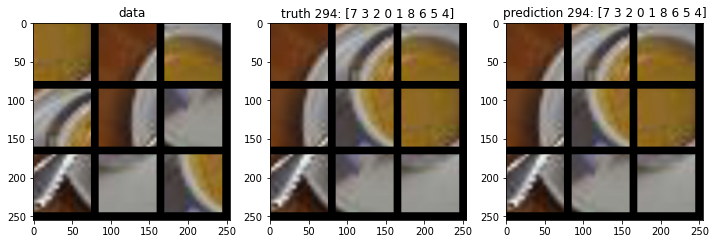

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[96/300]   476) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.128, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

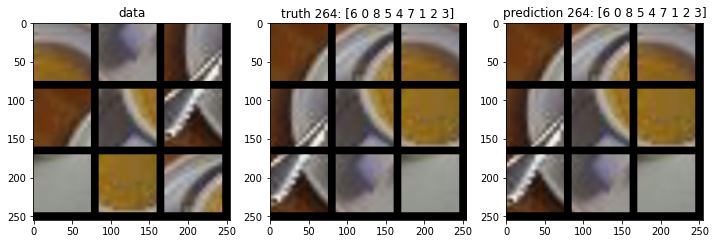

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[97/300]   480) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.993, Accuracy  70.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[97/300]   484) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.212, Accuracy  63.00%


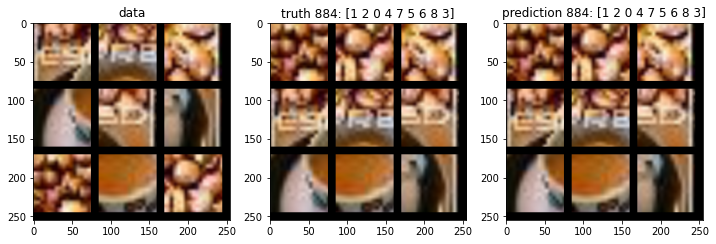

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[98/300]   488) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.077, Accuracy  74.00%


<Figure size 432x288 with 0 Axes>

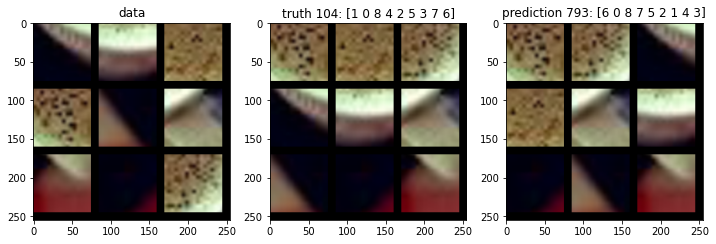

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[99/300]   492) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.025, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

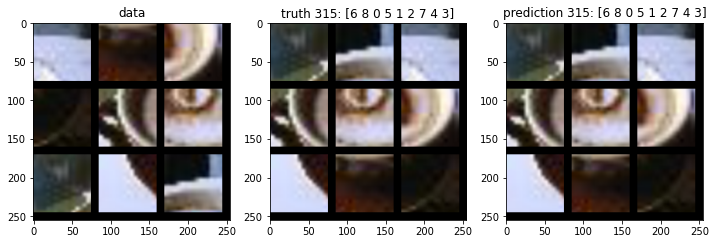

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[100/300]   496) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.010, Accuracy  72.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

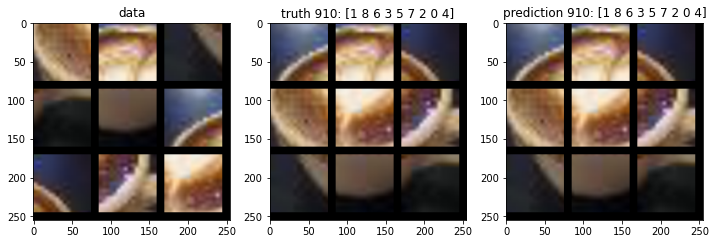

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[101/300]   500) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.066, Accuracy  71.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[101/300]   504) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.076, Accuracy  68.00%


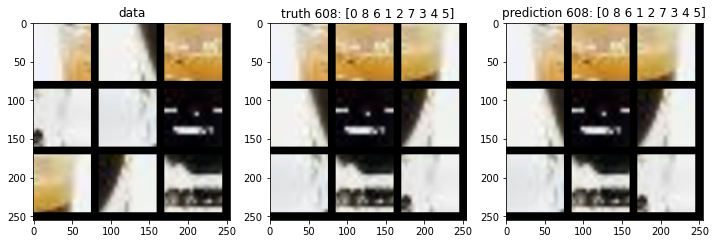

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[102/300]   508) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.048, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

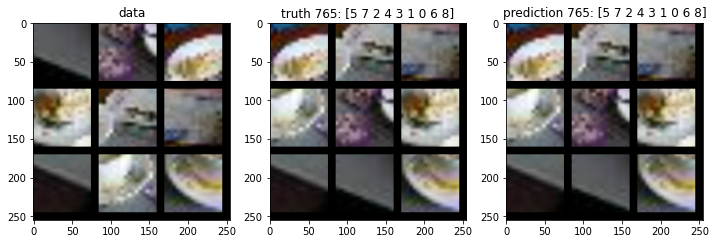

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[103/300]   512) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.082, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

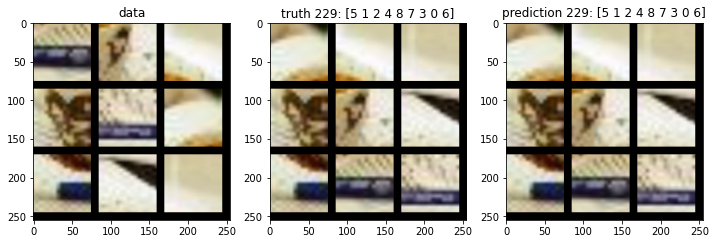

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[104/300]   516) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.079, Accuracy  70.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

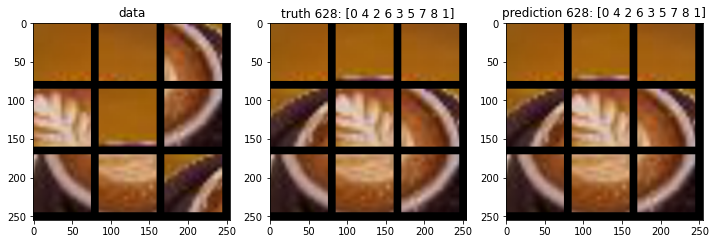

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[105/300]   520) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.129, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[105/300]   524) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.086, Accuracy  66.00%


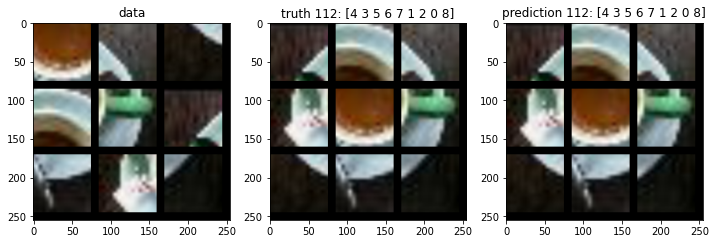

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[106/300]   528) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.219, Accuracy  60.00%


<Figure size 432x288 with 0 Axes>

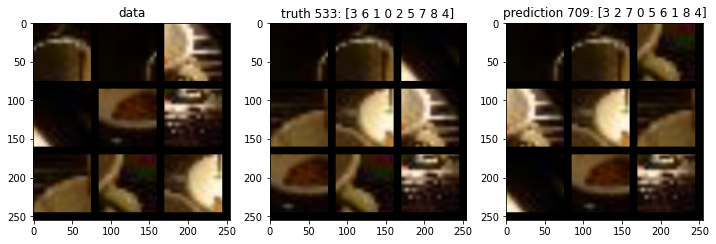

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[107/300]   532) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.091, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

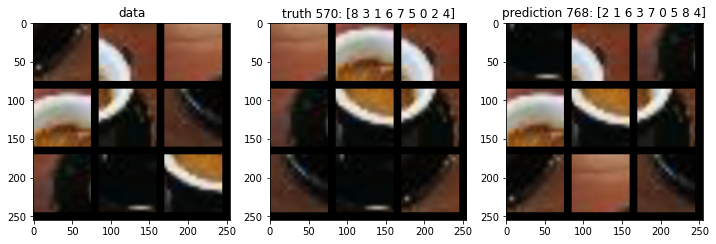

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[108/300]   536) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.963, Accuracy  71.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

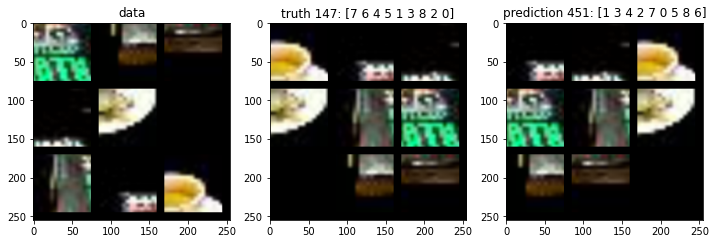

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[109/300]   540) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.156, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[109/300]   544) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.128, Accuracy  64.00%


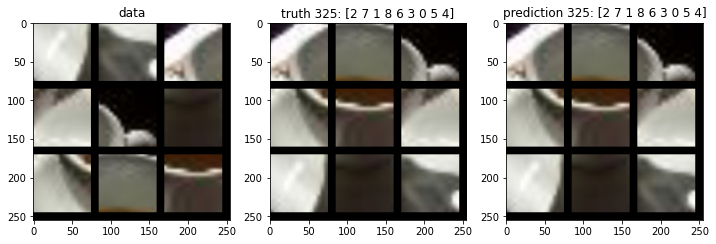

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[110/300]   548) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.169, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

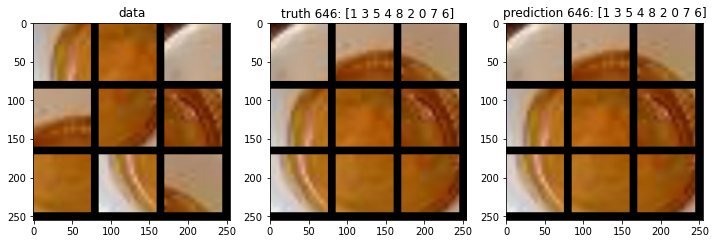

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[111/300]   552) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.108, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

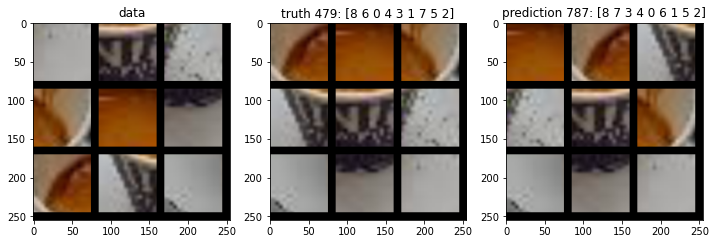

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[112/300]   556) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.169, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

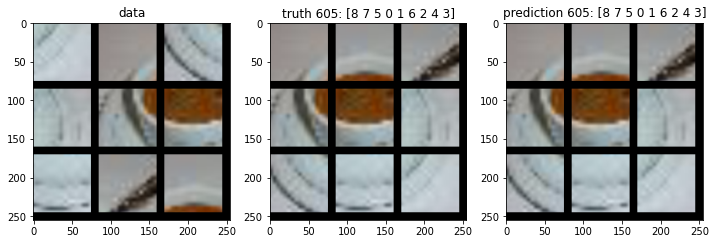

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[113/300]   560) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.147, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[113/300]   564) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.938, Accuracy  72.00%


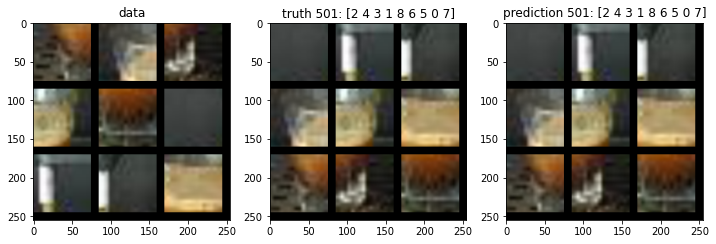

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[114/300]   568) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.078, Accuracy  70.00%


<Figure size 432x288 with 0 Axes>

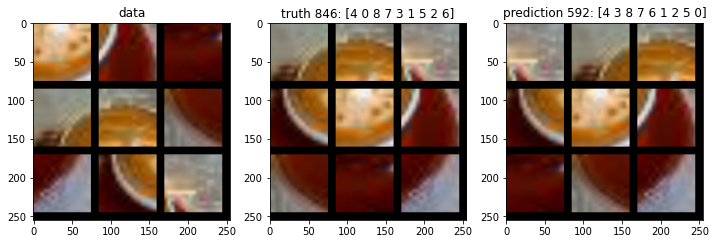

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[115/300]   572) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.068, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

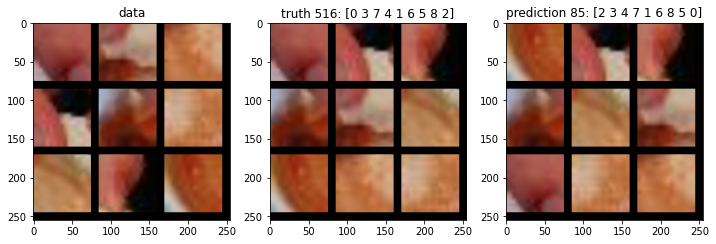

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[116/300]   576) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.199, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

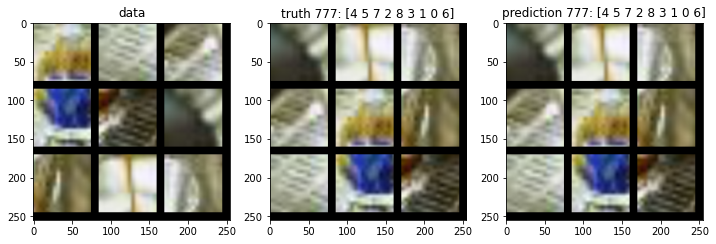

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[117/300]   580) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.307, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[117/300]   584) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.138, Accuracy  66.00%


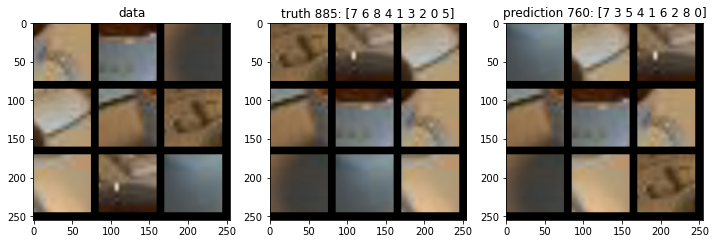

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[118/300]   588) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.892, Accuracy  82.00%


<Figure size 432x288 with 0 Axes>

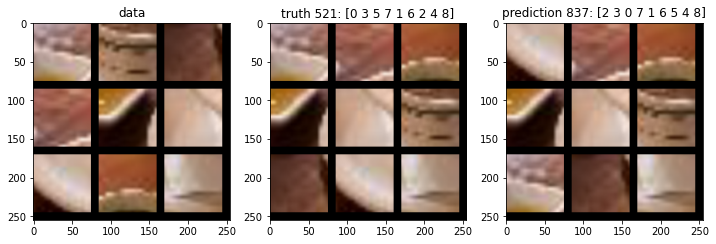

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[119/300]   592) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.124, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

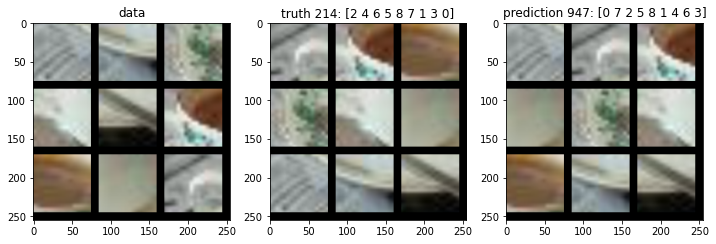

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[120/300]   596) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.157, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

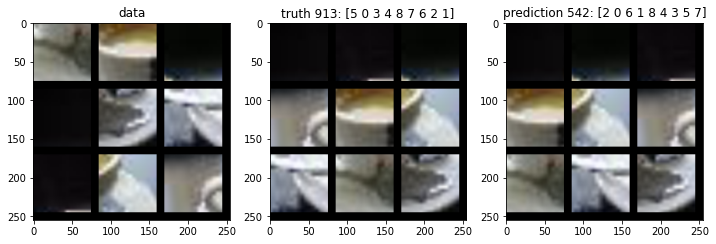

Learning Rate 0.000000


<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[121/300]   600) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.057, Accuracy  76.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 99.0
[121/300]   604) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.068, Accuracy  70.00%


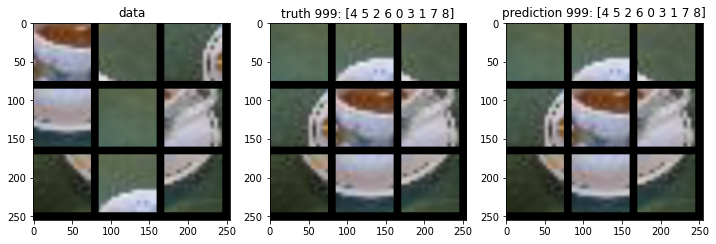

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[122/300]   608) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.060, Accuracy  74.00%


<Figure size 432x288 with 0 Axes>

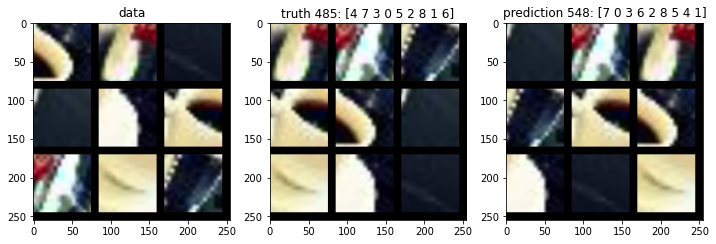

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[123/300]   612) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.282, Accuracy  63.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

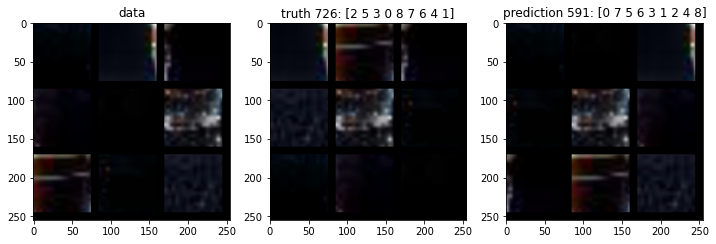

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[124/300]   616) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.167, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

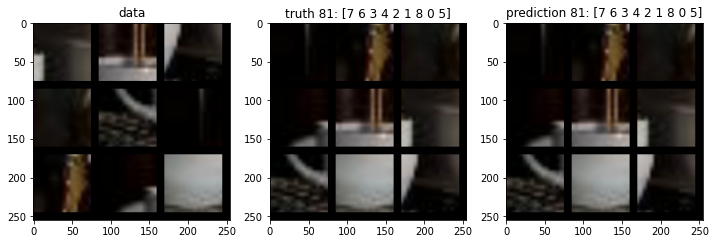

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 99.0
[125/300]   620) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.115, Accuracy  63.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[125/300]   624) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.227, Accuracy  63.00%


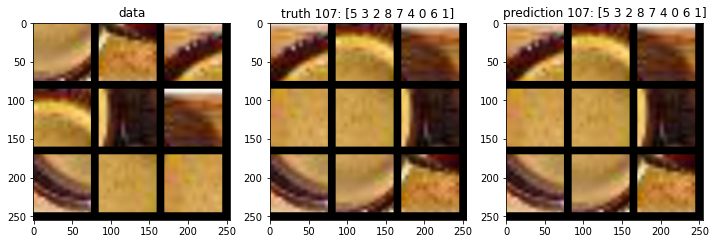

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[126/300]   628) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.078, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

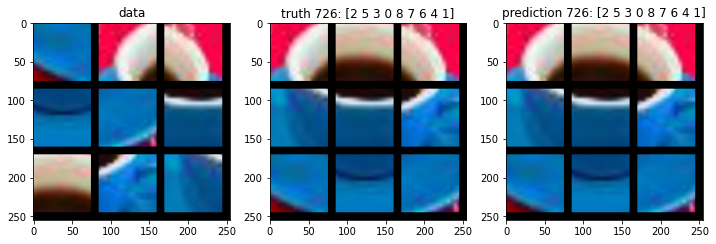

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 99.0
[127/300]   632) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.957, Accuracy  74.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

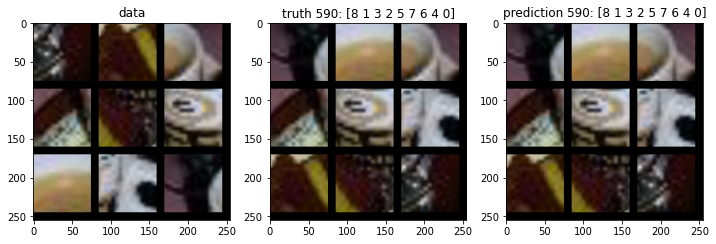

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[128/300]   636) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.926, Accuracy  77.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

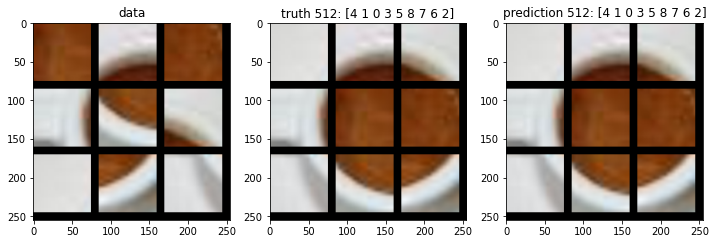

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[129/300]   640) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.138, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[129/300]   644) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.382, Accuracy  55.00%


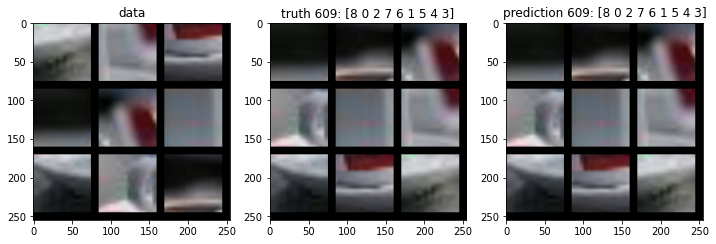

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[130/300]   648) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.007, Accuracy  71.00%


<Figure size 432x288 with 0 Axes>

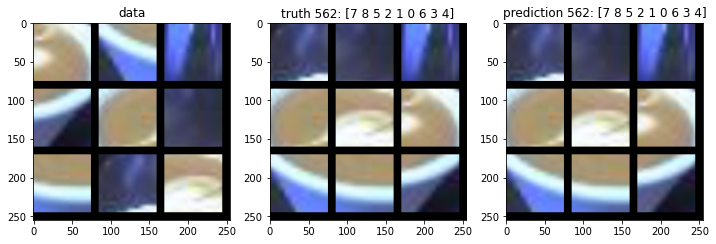

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[131/300]   652) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.198, Accuracy  61.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

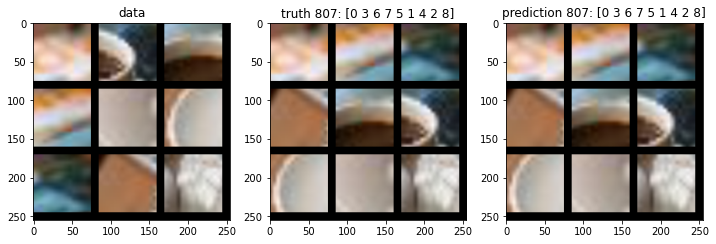

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[132/300]   656) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.113, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

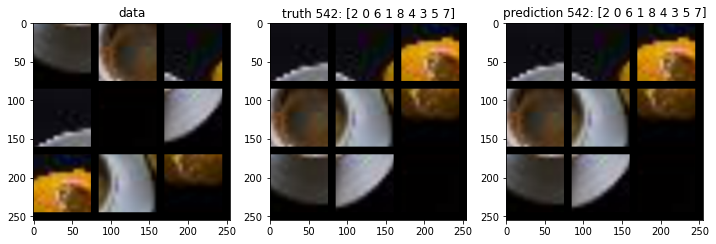

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 91.0
[133/300]   660) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.274, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[133/300]   664) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.208, Accuracy  66.00%


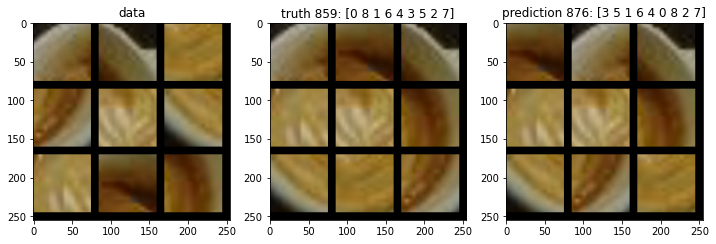

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[134/300]   668) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.981, Accuracy  74.00%


<Figure size 432x288 with 0 Axes>

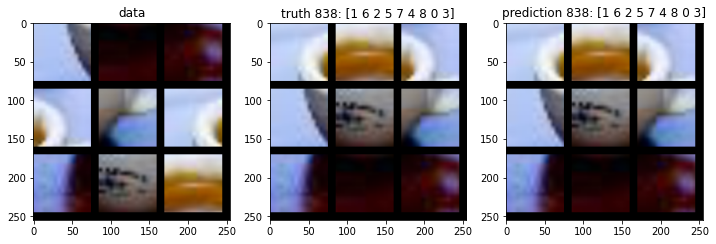

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[135/300]   672) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.087, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

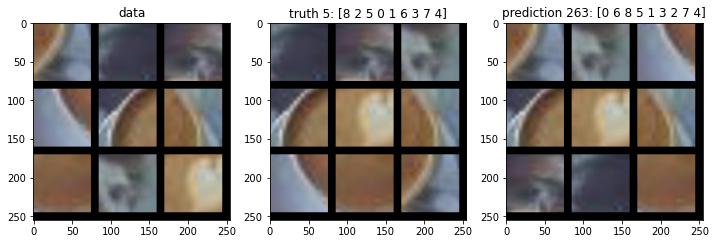

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[136/300]   676) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.097, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

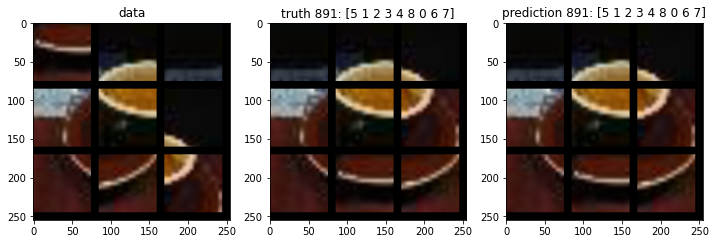

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[137/300]   680) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.181, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[137/300]   684) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.107, Accuracy  70.00%


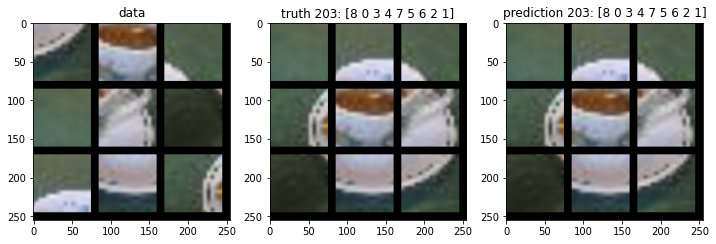

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[138/300]   688) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.041, Accuracy  70.00%


<Figure size 432x288 with 0 Axes>

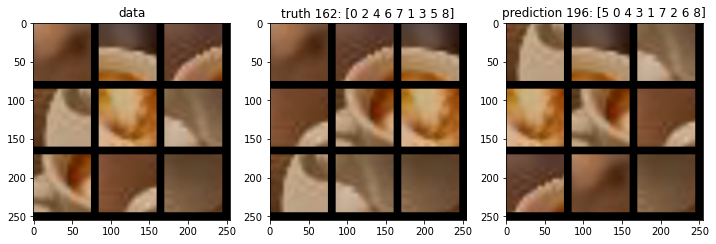

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[139/300]   692) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.110, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

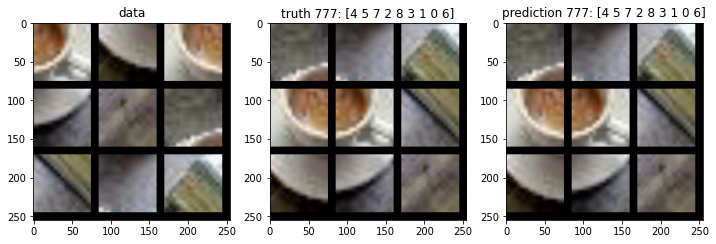

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[140/300]   696) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.174, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

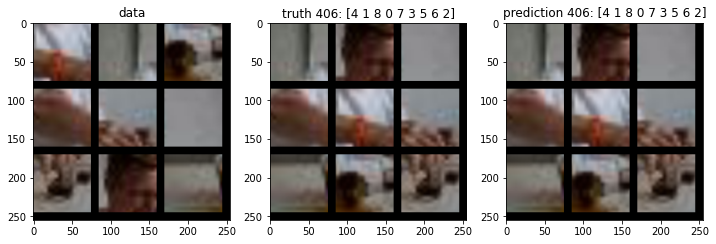

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[141/300]   700) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.097, Accuracy  73.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[141/300]   704) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.115, Accuracy  67.00%


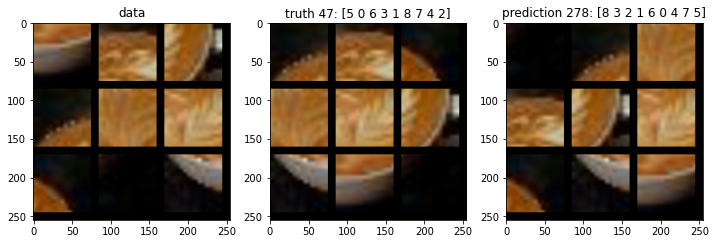

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[142/300]   708) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.220, Accuracy  58.00%


<Figure size 432x288 with 0 Axes>

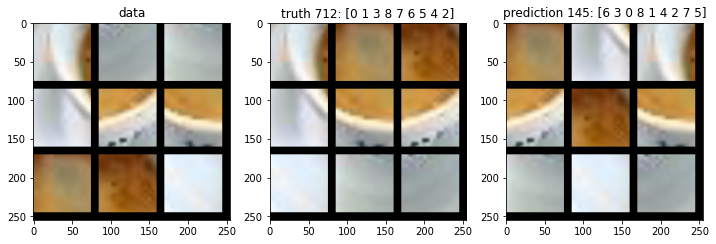

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[143/300]   712) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.131, Accuracy  71.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

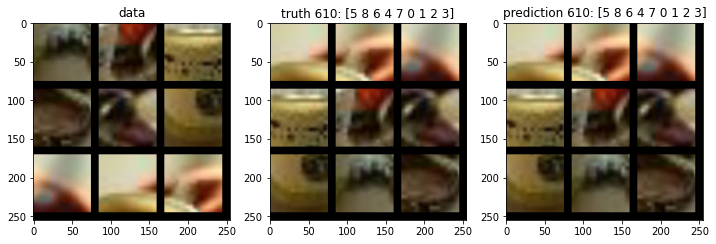

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[144/300]   716) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.171, Accuracy  70.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

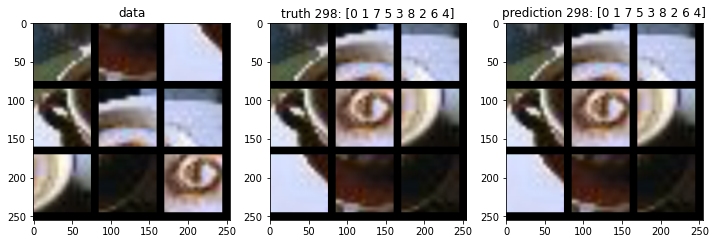

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[145/300]   720) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.303, Accuracy  56.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[145/300]   724) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.118, Accuracy  67.00%


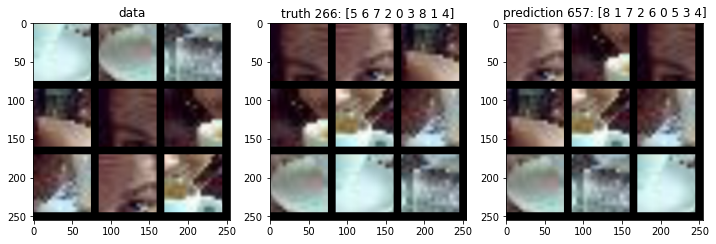

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[146/300]   728) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.095, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

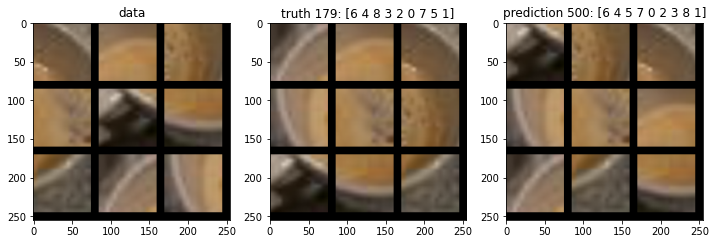

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[147/300]   732) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.147, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

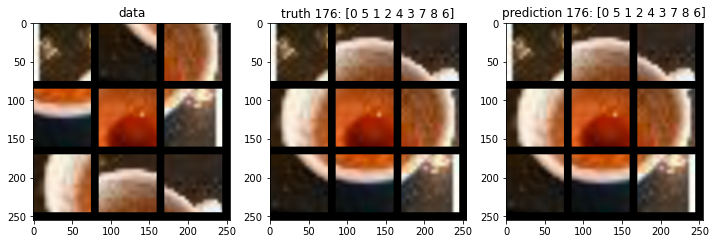

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[148/300]   736) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.034, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

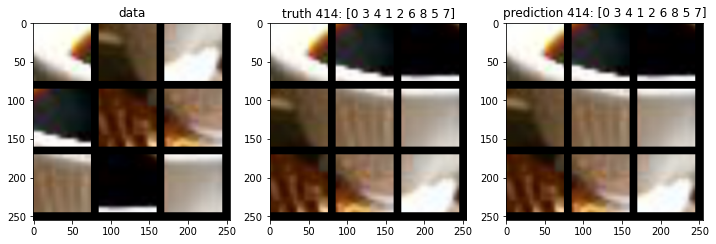

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[149/300]   740) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.264, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[149/300]   744) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.233, Accuracy  62.00%


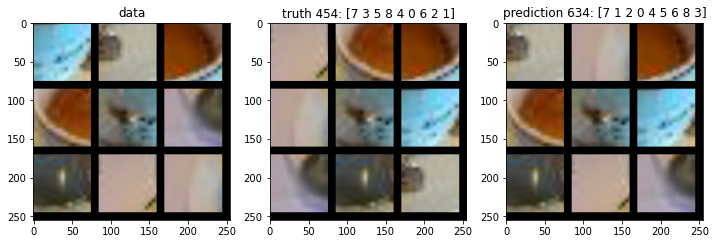

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[150/300]   748) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.160, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

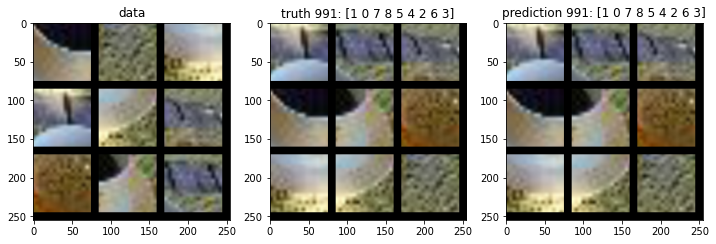

Learning Rate 0.000000


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[151/300]   752) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.109, Accuracy  70.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

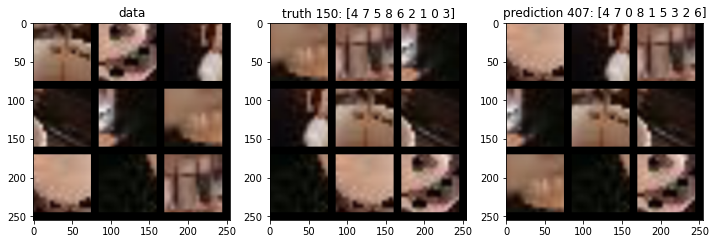

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[152/300]   756) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.174, Accuracy  59.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

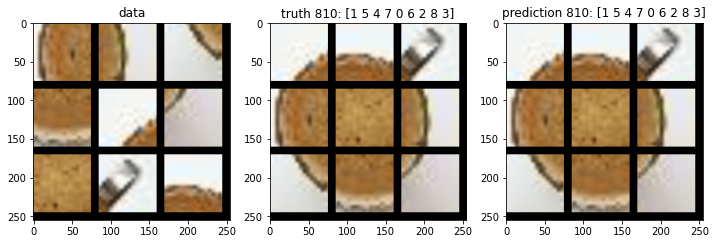

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[153/300]   760) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.981, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[153/300]   764) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.071, Accuracy  72.00%


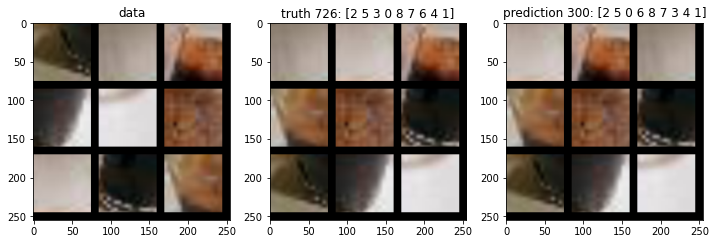

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[154/300]   768) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.066, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

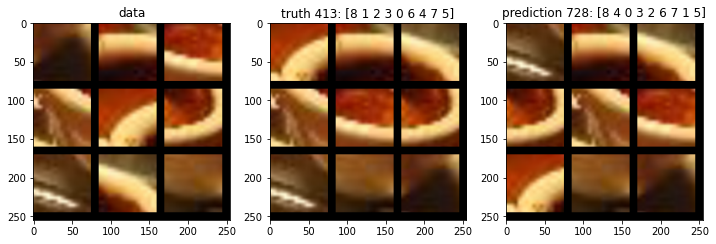

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 89.0
[155/300]   772) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.291, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

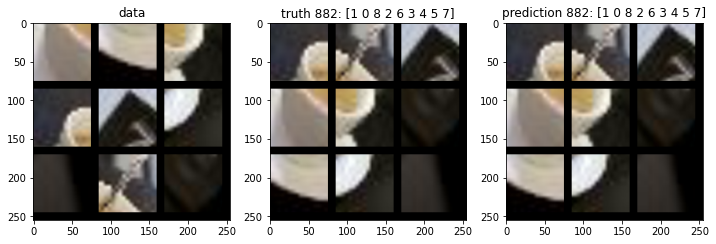

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[156/300]   776) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.170, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

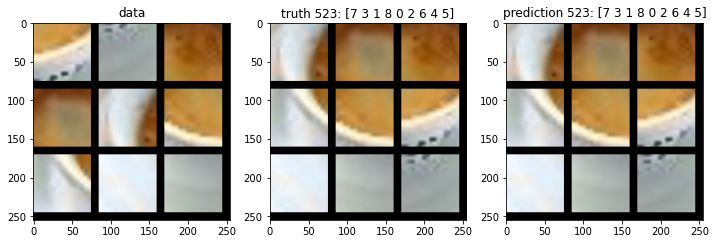

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[157/300]   780) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.260, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[157/300]   784) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.240, Accuracy  60.00%


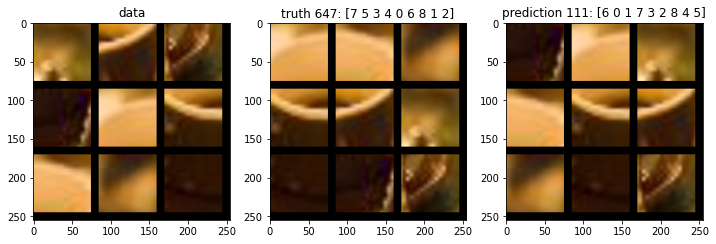

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[158/300]   788) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.025, Accuracy  71.00%


<Figure size 432x288 with 0 Axes>

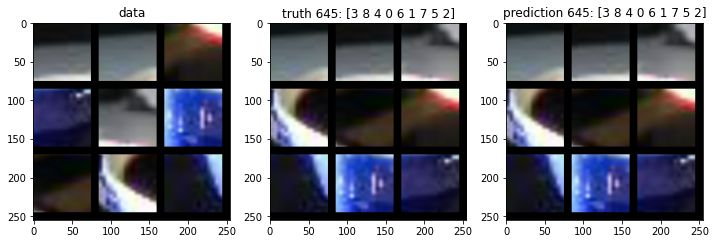

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[159/300]   792) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.211, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

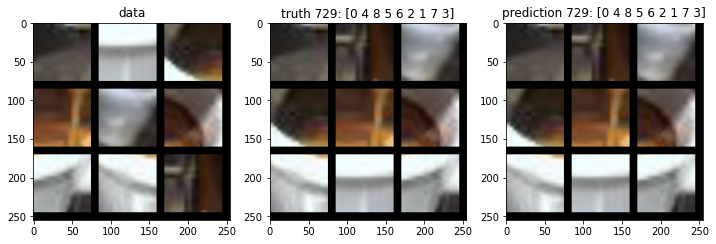

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[160/300]   796) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.151, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

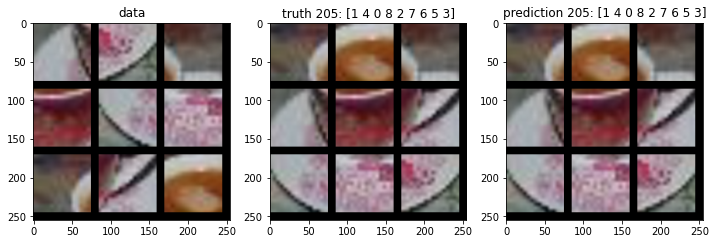

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 99.0
[161/300]   800) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.002, Accuracy  72.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[161/300]   804) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.229, Accuracy  57.00%


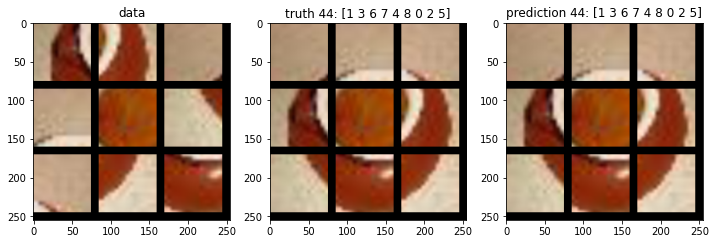

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[162/300]   808) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.222, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

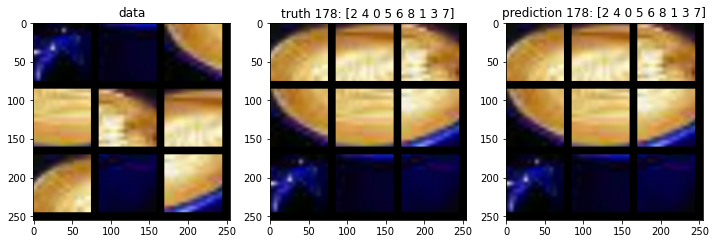

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[163/300]   812) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.222, Accuracy  60.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

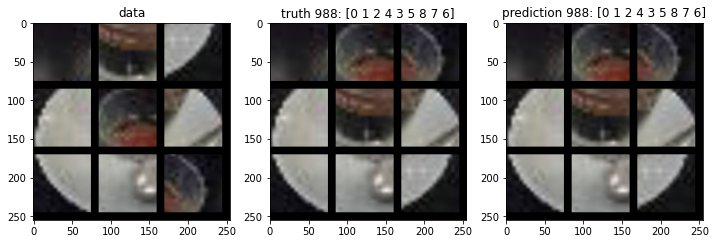

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[164/300]   816) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.205, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

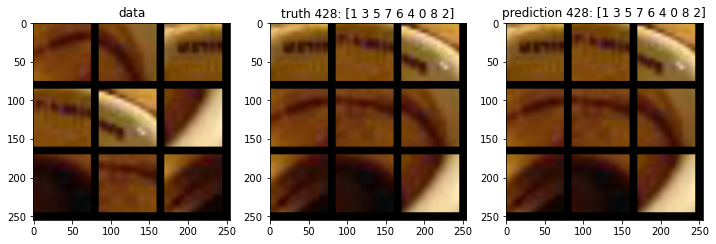

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[165/300]   820) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.044, Accuracy  75.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[165/300]   824) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.130, Accuracy  63.00%


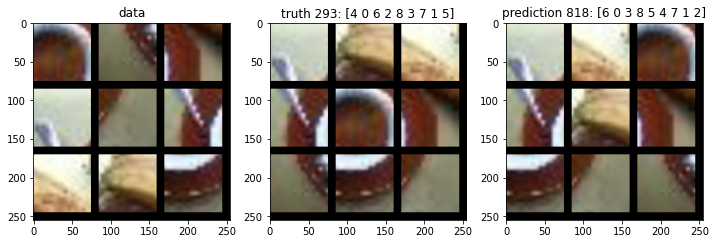

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[166/300]   828) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.042, Accuracy  73.00%


<Figure size 432x288 with 0 Axes>

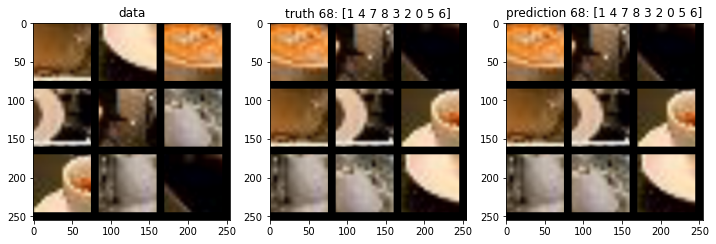

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[167/300]   832) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.958, Accuracy  76.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

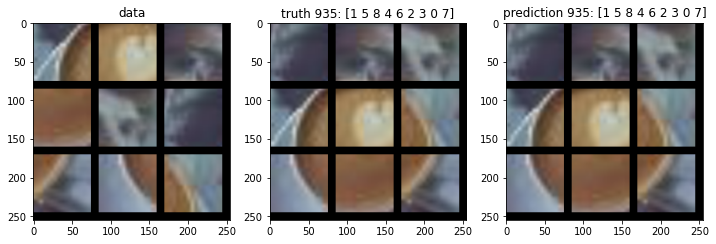

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[168/300]   836) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.195, Accuracy  62.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

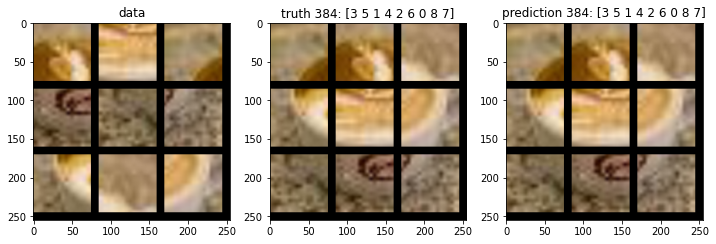

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[169/300]   840) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.171, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[169/300]   844) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.314, Accuracy  67.00%


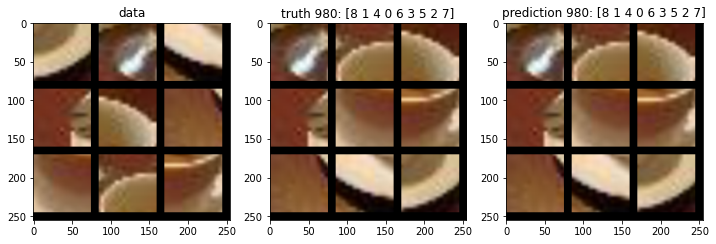

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[170/300]   848) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.167, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

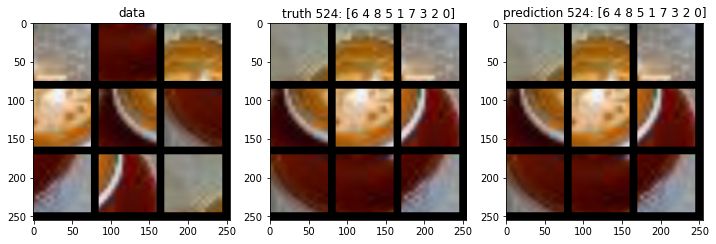

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[171/300]   852) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.966, Accuracy  81.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

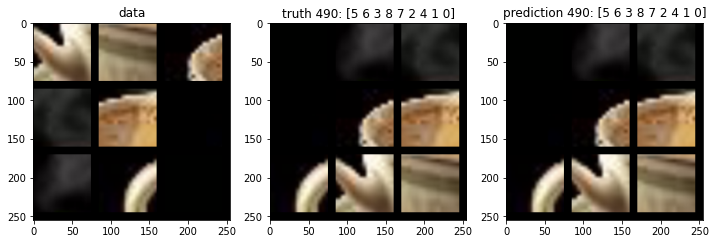

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[172/300]   856) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.297, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

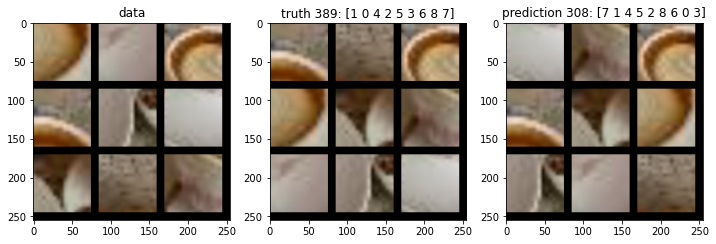

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[173/300]   860) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.230, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[173/300]   864) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.246, Accuracy  60.00%


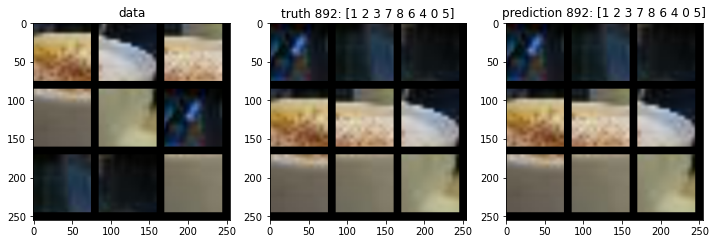

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[174/300]   868) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.001, Accuracy  75.00%


<Figure size 432x288 with 0 Axes>

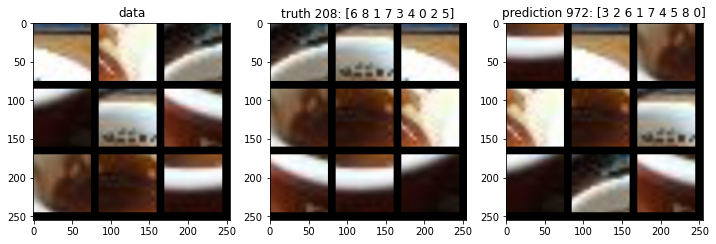

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[175/300]   872) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.013, Accuracy  76.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

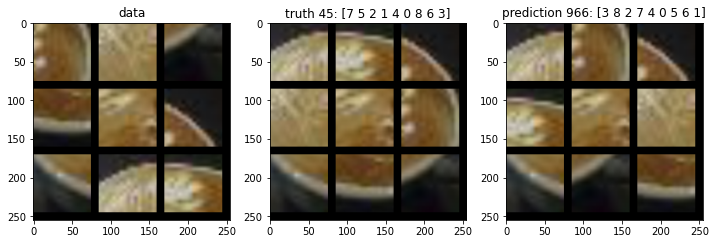

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[176/300]   876) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.206, Accuracy  60.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

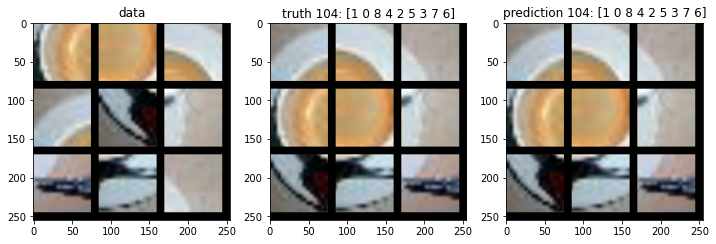

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[177/300]   880) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.150, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[177/300]   884) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.173, Accuracy  68.00%


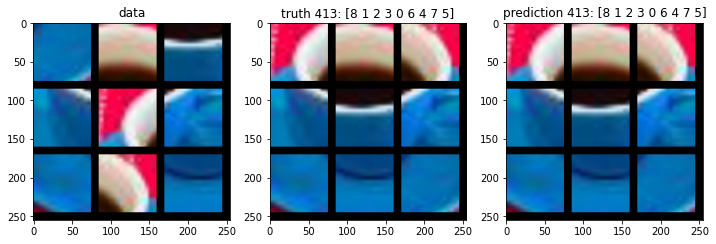

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[178/300]   888) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.231, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

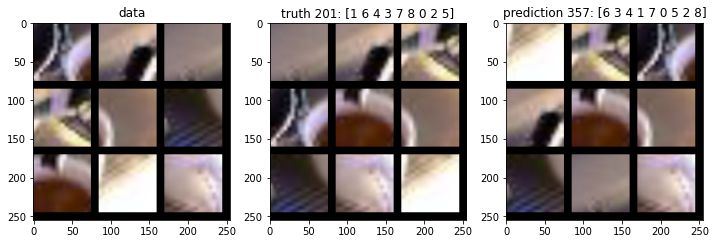

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 100.0
[179/300]   892) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.169, Accuracy  61.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

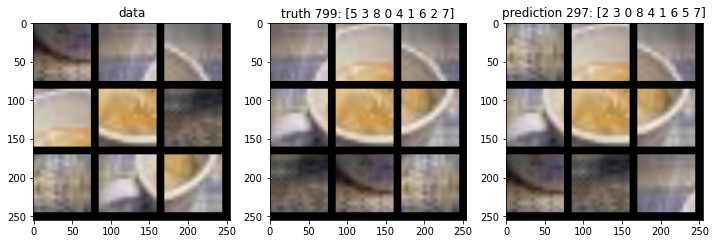

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[180/300]   896) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.006, Accuracy  72.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

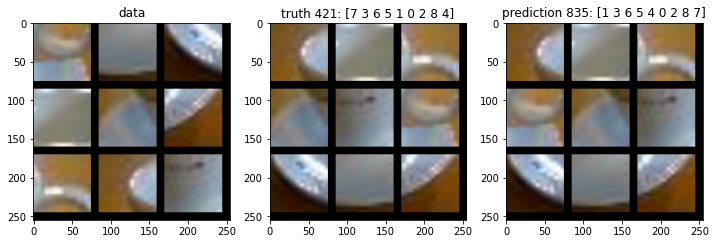

Learning Rate 0.000000


<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[181/300]   900) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.196, Accuracy  68.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[181/300]   904) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.076, Accuracy  72.00%


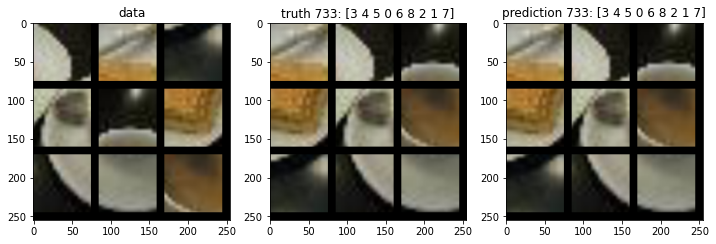

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[182/300]   908) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.024, Accuracy  76.00%


<Figure size 432x288 with 0 Axes>

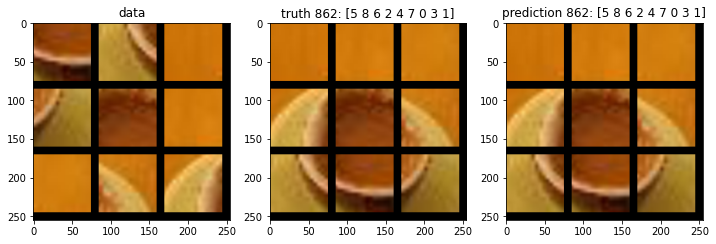

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[183/300]   912) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.093, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

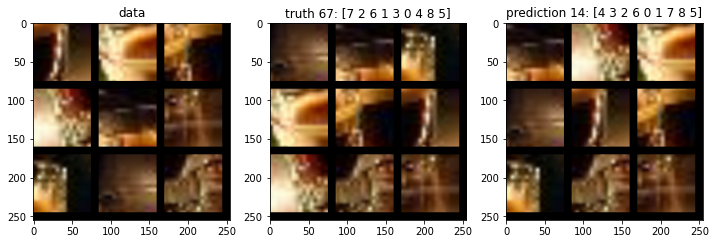

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[184/300]   916) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.157, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

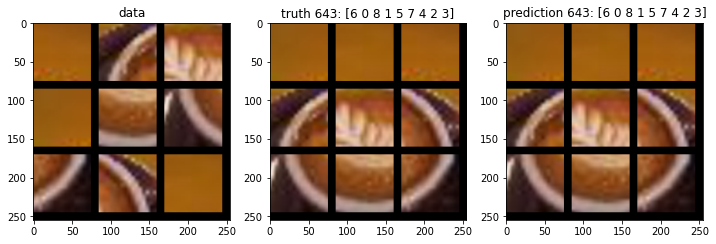

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[185/300]   920) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.058, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[185/300]   924) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.847, Accuracy  76.00%


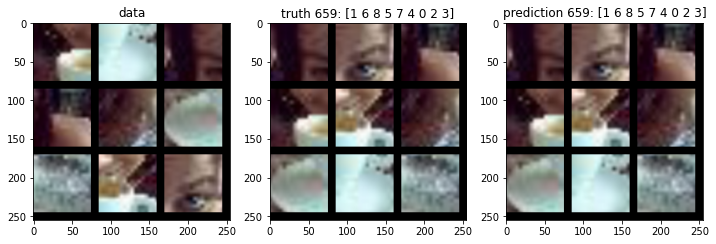

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[186/300]   928) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.217, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

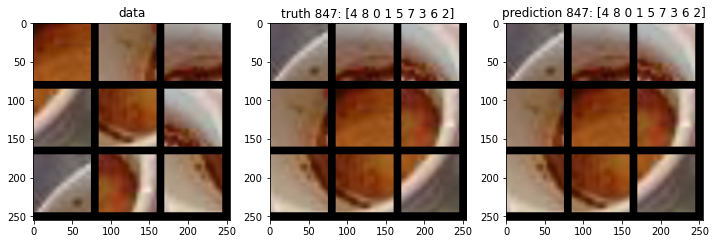

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[187/300]   932) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.232, Accuracy  60.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

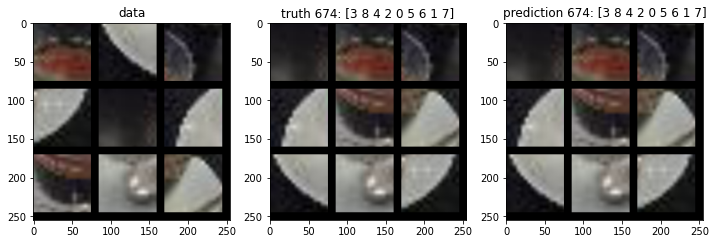

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[188/300]   936) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.384, Accuracy  57.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

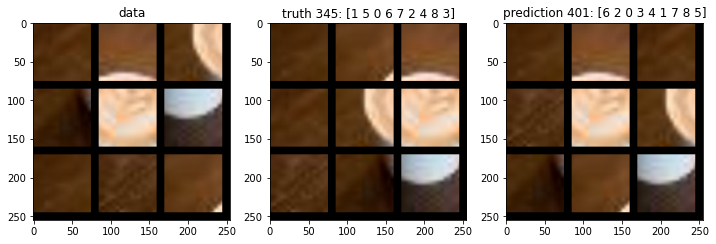

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[189/300]   940) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.211, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[189/300]   944) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.229, Accuracy  61.00%


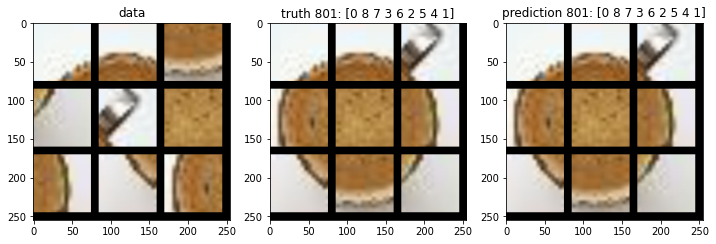

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[190/300]   948) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.247, Accuracy  63.00%


<Figure size 432x288 with 0 Axes>

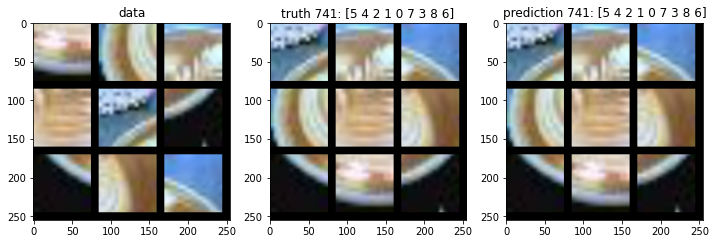

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[191/300]   952) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.083, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

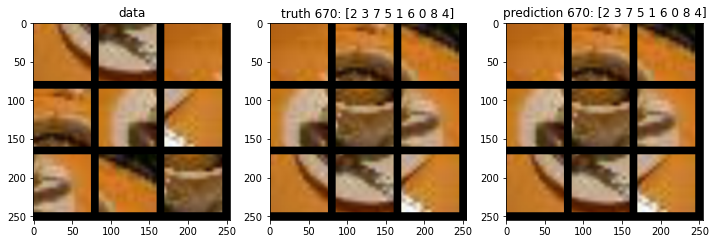

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[192/300]   956) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.054, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

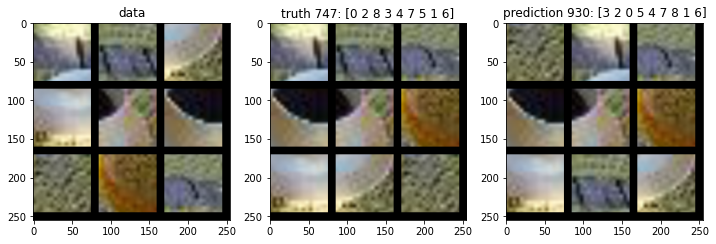

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[193/300]   960) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.240, Accuracy  55.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[193/300]   964) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.111, Accuracy  71.00%


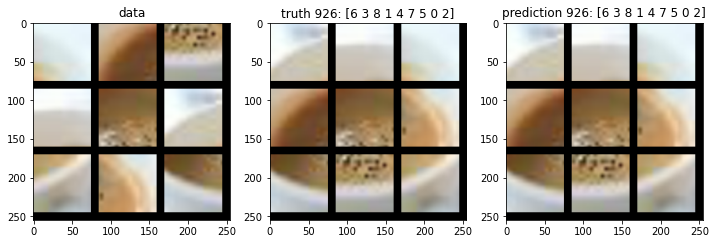

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[194/300]   968) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.140, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

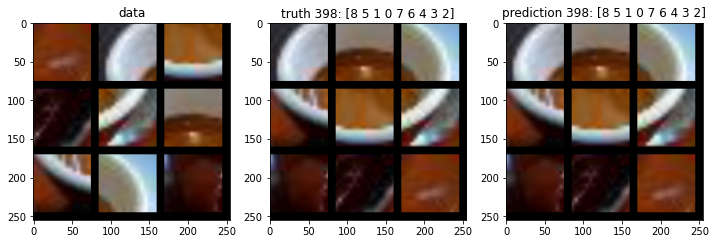

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 93.0
[195/300]   972) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.296, Accuracy  61.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

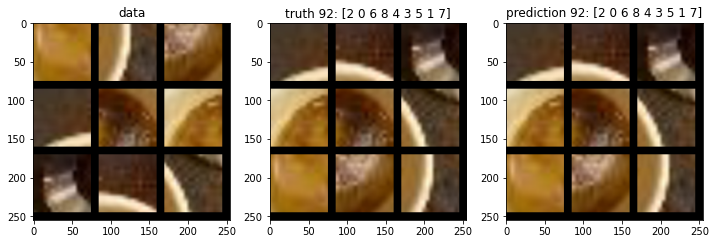

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[196/300]   976) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.170, Accuracy  64.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

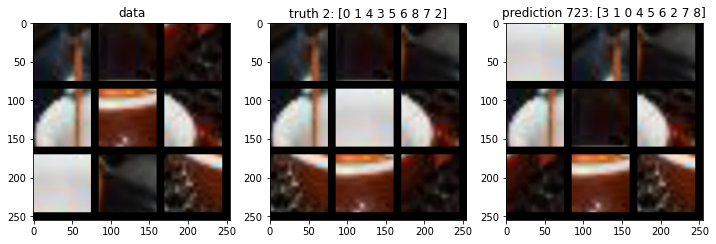

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[197/300]   980) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.275, Accuracy  61.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[197/300]   984) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.052, Accuracy  71.00%


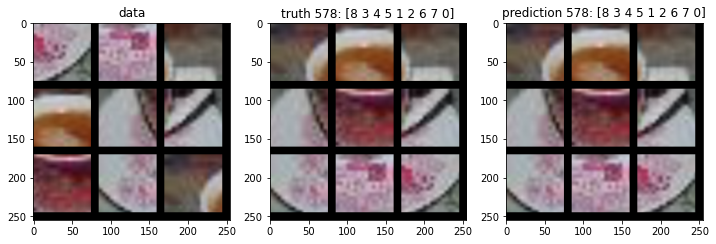

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[198/300]   988) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.995, Accuracy  76.00%


<Figure size 432x288 with 0 Axes>

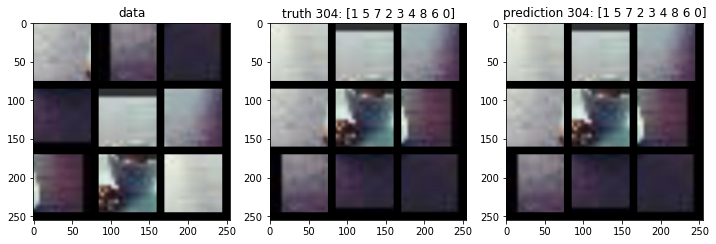

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[199/300]   992) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.973, Accuracy  72.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

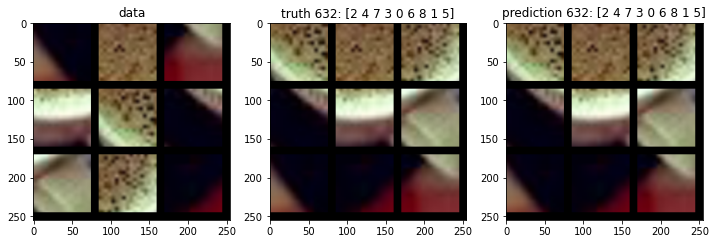

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[200/300]   996) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.155, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

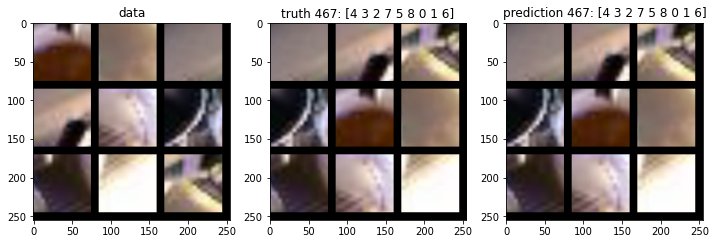

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 99.0
[201/300]  1000) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  0.965, Accuracy  74.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 95.0
[201/300]  1004) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.126, Accuracy  70.00%


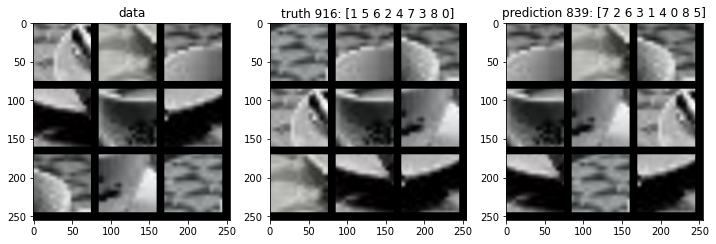

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[202/300]  1008) [batch load  0.016sec, net 0.04sec], LR 0.00000, Loss:  1.218, Accuracy  59.00%


<Figure size 432x288 with 0 Axes>

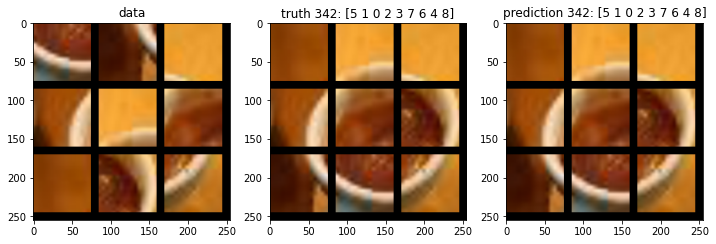

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[203/300]  1012) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.110, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

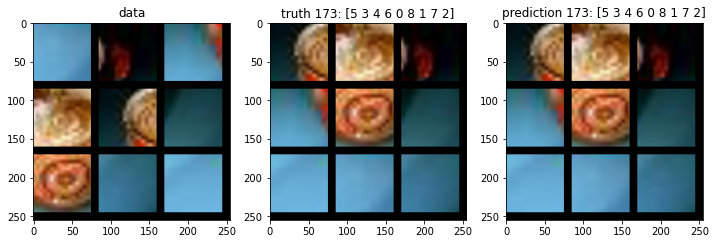

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 99.0
[204/300]  1016) [batch load  0.016sec, net 0.04sec], LR 0.00000, Loss:  0.934, Accuracy  76.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

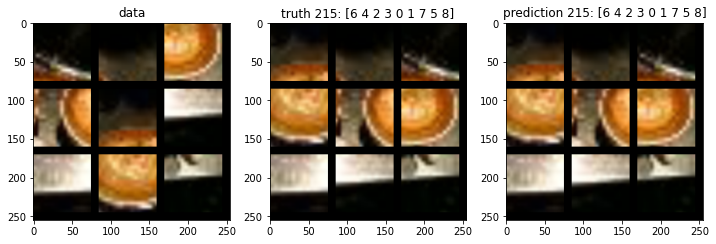

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[205/300]  1020) [batch load  0.016sec, net 0.04sec], LR 0.00000, Loss:  0.960, Accuracy  76.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[205/300]  1024) [batch load  0.016sec, net 0.04sec], LR 0.00000, Loss:  1.074, Accuracy  67.00%


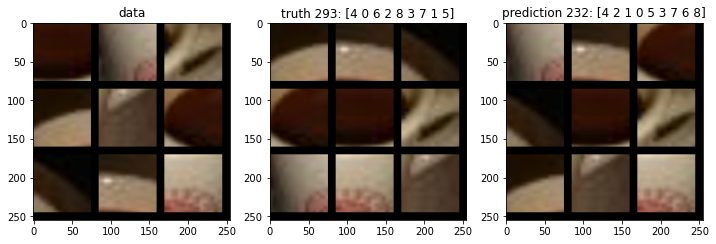

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 94.0
[206/300]  1028) [batch load  0.016sec, net 0.04sec], LR 0.00000, Loss:  1.115, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

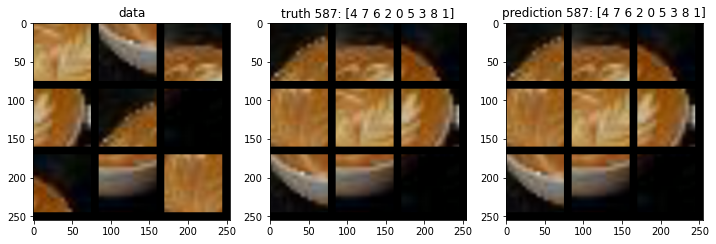

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 91.0
[207/300]  1032) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.433, Accuracy  66.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

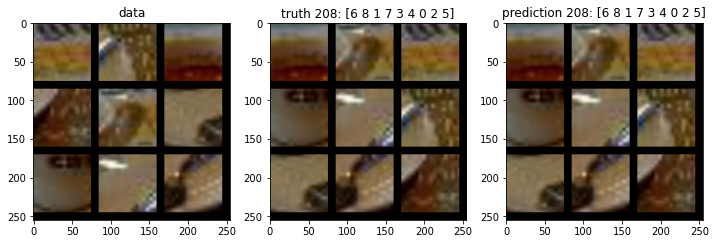

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 99.0
[208/300]  1036) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.007, Accuracy  72.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

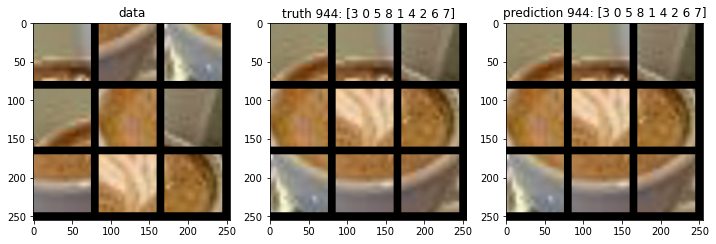

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[209/300]  1040) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.147, Accuracy  69.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 99.0
[209/300]  1044) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.104, Accuracy  70.00%


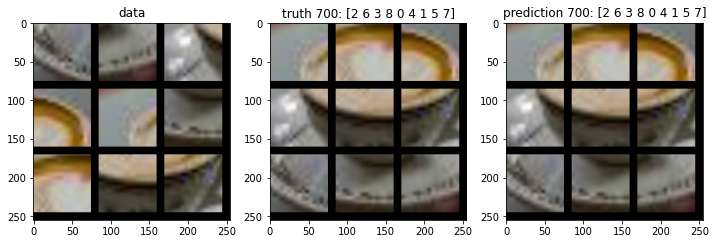

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 92.0
[210/300]  1048) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.231, Accuracy  65.00%


<Figure size 432x288 with 0 Axes>

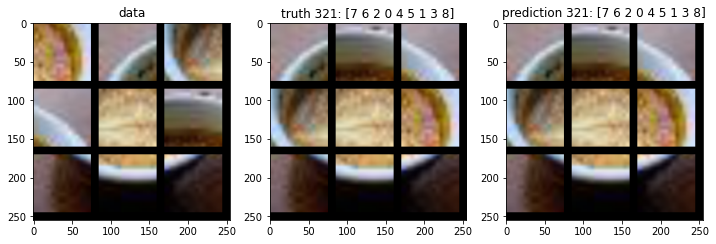

Learning Rate 0.000000


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 96.0
[211/300]  1052) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.166, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

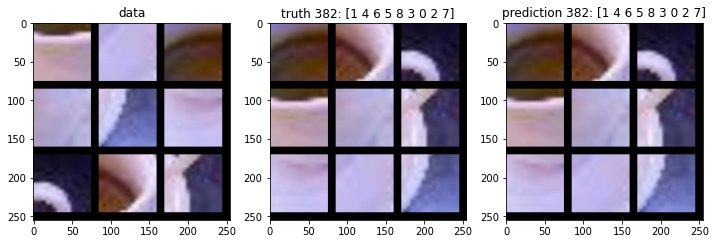

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 97.0
[212/300]  1056) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.025, Accuracy  67.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

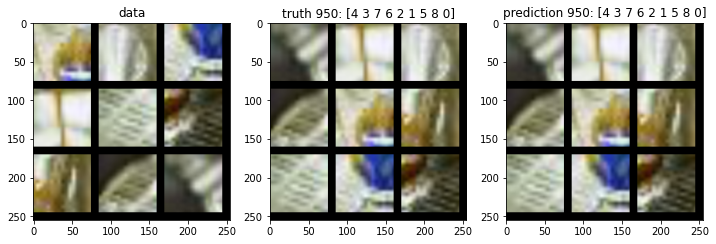

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 91.0
[213/300]  1060) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.247, Accuracy  63.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[213/300]  1064) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.000, Accuracy  72.00%


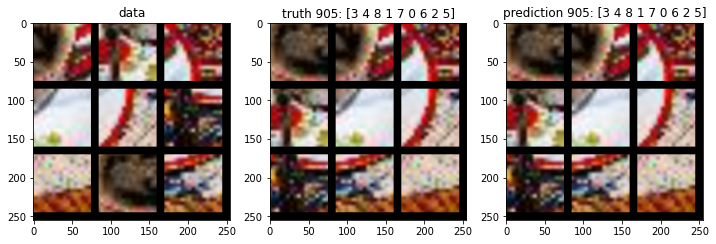

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[214/300]  1068) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.132, Accuracy  70.00%


<Figure size 432x288 with 0 Axes>

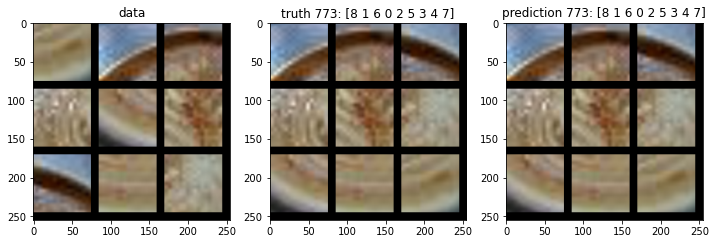

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

Top 5 accuracy 98.0
[215/300]  1072) [batch load  0.017sec, net 0.04sec], LR 0.00000, Loss:  1.035, Accuracy  72.00%


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

In [ ]:
args = easydict.EasyDict({'data': 'gdrive/MyDrive/Colab Notebooks/deep learning/final/small-tiny-imagenet-200/',
          'model':None,
          'classes':1000,
          'gpu' : 1,
          'epochs' : 300,
          'iter_start' : 0,
          'batch' : 100,
          'lr' : 0.001,
          'cores' : 0,
          'checkpoint' : 'ss',  
          'evaluate' : 0
          })


model = JigResnet()
model.load_state_dict(torch.load(model_path + "/JigResnet18")) # train with the last trained model
if args.gpu is not None:
    model.cuda()


criterion = nn.CrossEntropyLoss()
#criterion = nn.PoissonNLLLoss()

trainpath =  'train/n07920052/images'
txtpath = 'train/n07920052/n07920052_boxes.txt'

valpath = 'train/n09256479/images'
val_txtpath = '/train/n09256479/n09256479_boxes.txt'

batch_time, net_time = [], []
optimizer = torch.optim.SGD(model.parameters(),lr=args.lr,momentum=0.9,weight_decay = 5e-4)

iter_per_epoch = 1
train_data = DataLoader(args.data + trainpath,args.data + txtpath,
                      classes=args.classes) 

train_loader = torch.utils.data.DataLoader(dataset=train_data,
                      batch_size=args.batch,
                      shuffle=True,
                      num_workers=args.cores)
losses = np.zeros(int(args.epochs*(len(train_data)/args.batch)))
steps = 0
lr = args.lr
for epoch in range(int(args.iter_start/iter_per_epoch),args.epochs):
    if epoch % 30 == 0 and epoch != 0:
      lr = adjust_learning_rate(optimizer, epoch, init_lr=args.lr, step=10, decay=0.5)

    for i, (data, true_index, original) in enumerate(train_loader):

      
      one_image = data
      one_label = true_index
      one_truth = original


 
      
      end = time()

      images = one_image.clone()
      labels = one_label.clone()


      plt.suptitle('Overall Title')
      plt.show()

      batch_time.append(time()-end)
      if len(batch_time)>100:
          del batch_time[0]
      images = Variable(torch.tensor(images))
      labels = Variable(torch.tensor(labels))
      if args.gpu is not None:
          images = images.cuda()
          labels = labels.cuda()

      # Forward + Backward + Optimize
      optimizer.zero_grad()
      t = time()
      #print(images.size())
      outputs = model(images)
      net_time.append(time()-t)
      if len(net_time)>100:
          del net_time[0]

      prec1, prec5 = compute_accuracy(outputs.cpu().data, labels.cpu().data, topk=(1, 5))

      acc = prec1.item()

      loss = criterion(outputs, labels)
      losses[steps] = loss.item()

      loss.backward()
      optimizer.step()
      loss = float(loss.cpu().data.numpy())
 

      if steps%4==0:
          print('Top 5 accuracy {}'.format(prec5.item()))
          print(('[%2d/%2d] %5d) [batch load % 2.3fsec, net %1.2fsec], LR %.5f, Loss: % 1.3f, Accuracy % 2.2f%%' %(
                      epoch+1, args.epochs, steps, 
                      np.mean(batch_time), np.mean(net_time),
                      lr, loss,acc)))



      steps += 1
  
 
      
      end = time()
    visualization(images[0].cpu(),perms,labels[0].detach().cpu(),outputs[0].argmax())


In [ ]:
#torch.save(model.state_dict(), os.path.join('gdrive/MyDrive', 'JigResnet18'))

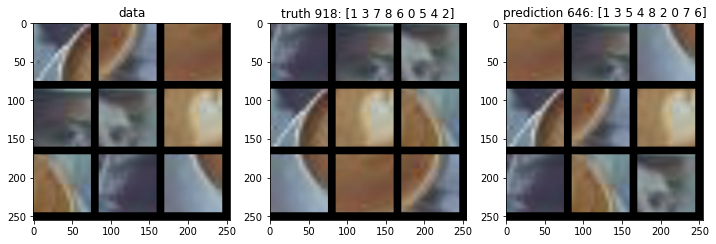

In [ ]:
#visualization(images[0].cpu(),perms,labels[0].detach().cpu(),outputs[0].argmax())

# Train with one image

Learning Rate 0.010000


/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:281: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "


<Figure size 432x288 with 0 Axes>

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:42: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:43: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


torch.Size([9, 3, 75, 75]) torch.Size([]) torch.Size([1, 1000])


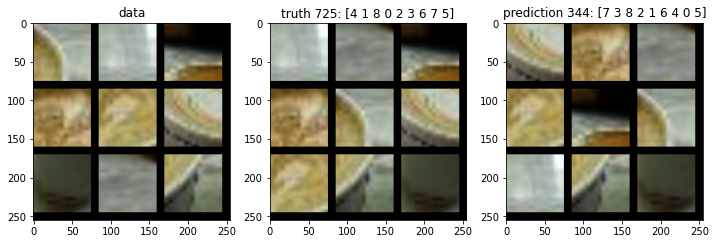

Learning Rate 0.010000


<Figure size 432x288 with 0 Axes>

torch.Size([9, 3, 75, 75]) torch.Size([]) torch.Size([1, 1000])


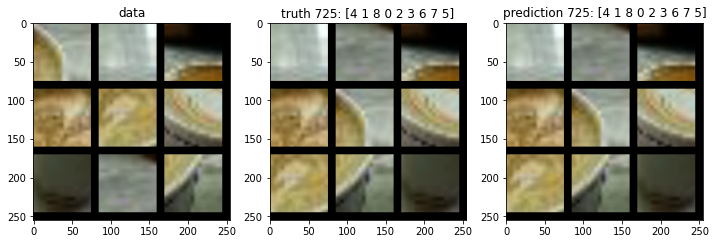

Learning Rate 0.010000


<Figure size 432x288 with 0 Axes>

torch.Size([9, 3, 75, 75]) torch.Size([]) torch.Size([1, 1000])


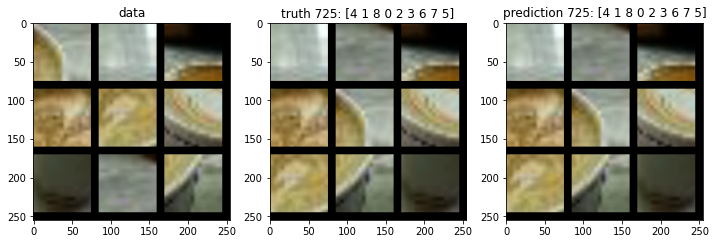

[ 3/10]    12) [batch load  12.205sec, net 0.03sec], LR 0.01000, Loss:  0.007, Accuracy  100.00%
Learning Rate 0.010000


<Figure size 432x288 with 0 Axes>

torch.Size([9, 3, 75, 75]) torch.Size([]) torch.Size([1, 1000])


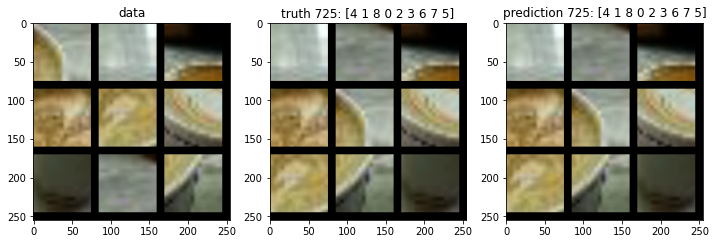

Learning Rate 0.010000


<Figure size 432x288 with 0 Axes>

torch.Size([9, 3, 75, 75]) torch.Size([]) torch.Size([1, 1000])


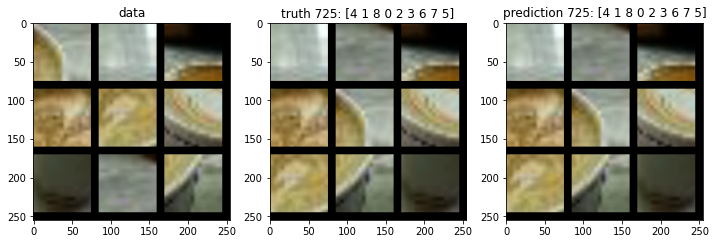

Learning Rate 0.010000


<Figure size 432x288 with 0 Axes>

torch.Size([9, 3, 75, 75]) torch.Size([]) torch.Size([1, 1000])


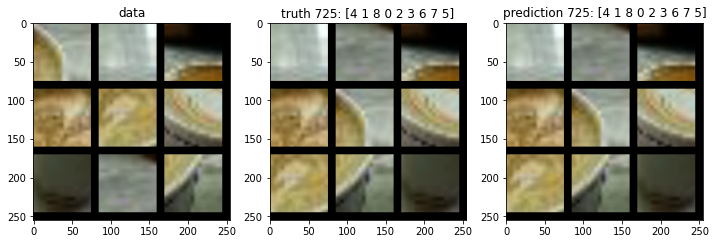

Learning Rate 0.010000


<Figure size 432x288 with 0 Axes>

torch.Size([9, 3, 75, 75]) torch.Size([]) torch.Size([1, 1000])


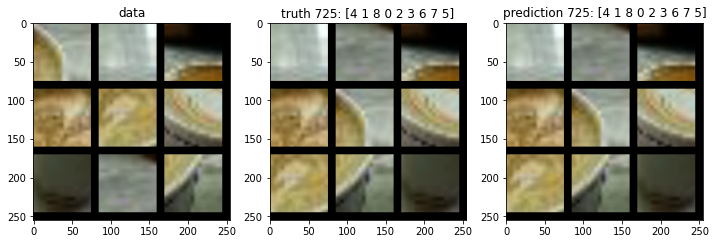

[ 7/10]    16) [batch load  9.337sec, net 0.03sec], LR 0.01000, Loss:  0.000, Accuracy  100.00%
Learning Rate 0.010000


<Figure size 432x288 with 0 Axes>

torch.Size([9, 3, 75, 75]) torch.Size([]) torch.Size([1, 1000])


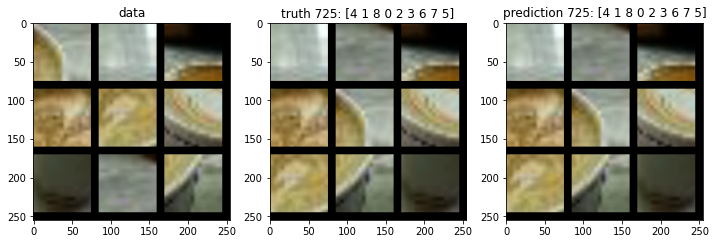

Learning Rate 0.010000


<Figure size 432x288 with 0 Axes>

torch.Size([9, 3, 75, 75]) torch.Size([]) torch.Size([1, 1000])


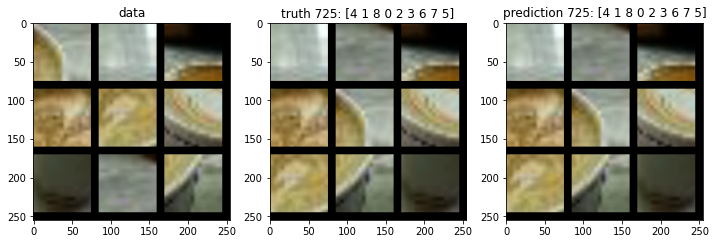

Learning Rate 0.010000


<Figure size 432x288 with 0 Axes>

torch.Size([9, 3, 75, 75]) torch.Size([]) torch.Size([1, 1000])


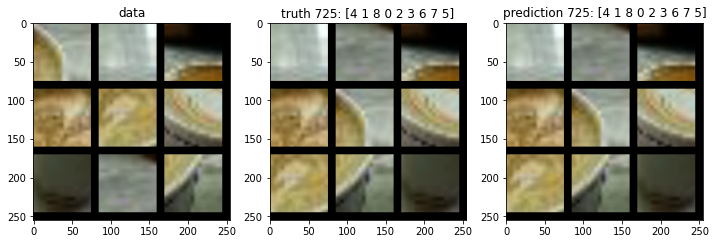

In [ ]:

net = JigResnet()
net.load_state_dict(torch.load(model_path + "/JigResnet18"))
if args.gpu is not None:
    net.cuda()


criterion = nn.CrossEntropyLoss()

optimizer = torch.optim.SGD(net.parameters(),lr=args.lr,momentum=0.9,weight_decay = 5e-4)
args.epochs = 10
args.lr = 0.01
iter_per_epoch = 1

train_data = DataLoader(args.data + trainpath,args.data + txtpath,
                      classes=args.classes) 

train_loader = torch.utils.data.DataLoader(dataset=train_data,
                      batch_size=args.batch,
                      shuffle=True,
                      num_workers=args.cores)

one_image = data[0]
one_label = true_index[0]
one_truth = original[:][0]
for epoch in range(int(args.iter_start/iter_per_epoch),args.epochs):

    lr = adjust_learning_rate(optimizer, epoch, init_lr=args.lr, step=50, decay=0.5)
    
    end = time()

    images = one_image.clone()
    labels = one_label.clone()

    plt.suptitle('Overall Title')
    plt.show()

    batch_time.append(time()-end)
    if len(batch_time)>100:
        del batch_time[0]

    images = Variable(torch.tensor(images))
    labels = Variable(torch.tensor(labels))
    if args.gpu is not None:
        images = images.cuda()
        labels = labels.cuda()

    # Forward + Backward + Optimize
    optimizer.zero_grad()
    t = time()
    outputs = net(images.view(-1,9,3,75,75))
    net_time.append(time()-t)
    if len(net_time)>100:
        del net_time[0]
    prec1, prec5 = compute_accuracy(outputs.cpu().data, labels.view(1,1).cpu().data, topk=(1, 5))
    acc = prec1.item()
    loss = criterion(outputs, labels.view(1))
    loss.backward()
    optimizer.step()
    loss = float(loss.cpu().data.numpy())
    print(images.cpu().shape,labels.detach().cpu().shape,outputs.detach().cpu().shape)
    visualization(images.cpu(),perms,labels.detach().cpu(),outputs.argmax())

    if steps%4==0:
        print(('[%2d/%2d] %5d) [batch load % 2.3fsec, net %1.2fsec], LR %.5f, Loss: % 1.3f, Accuracy % 2.2f%%' %(
                    epoch+1, args.epochs, steps, 
                    np.mean(batch_time), np.mean(net_time),
                    lr, loss,acc)))


    steps += 1

    if steps%1000==0:
        filename = '%s/jps_%03i_%06d.pth.tar'%(args.checkpoint,epoch,steps)
        net.save(filename)
        print('Saved: '+args.checkpoint)
    
    end = time()
